# Data Mining Lab 2
In this lab session we will focus on the use of Neural Word Embeddings and exploring some basic open source LLMs' applications to data.

## Table of Contents
1. Data preparation
2. Feature engineering
3. Model
4. Results evaluation
5. Other things you could try
6. Deep Learning
7. Word to Vector
8. Clustering
9. High-dimension Visualization
10. Large Language Models (LLMs)


### Necessary Library Requirements:

#### Same as Lab1 except PAMI:
- [Jupyter](http://jupyter.org/) (Strongly recommended but not required)
    - Install via `pip3 install jupyter` and use `jupyter notebook` in terminal to run
- [Scikit Learn](http://scikit-learn.org/stable/index.html)
    - Install via `pip3 install scikit-learn` from a terminal
- [Pandas](http://pandas.pydata.org/)
    - Install via `pip3 install pandas` from a terminal
- [Numpy](http://www.numpy.org/)
    - Install via `pip3 install numpy` from a terminal
- [Matplotlib](https://matplotlib.org/)
    - Install via `pip3 install maplotlib` from a terminal
- [Plotly](https://plot.ly/)
    - Install via `pip3 install plotly` from a terminal
- [Seaborn](https://seaborn.pydata.org/)
    - Install via `pip3 install seaborn`
- [NLTK](http://www.nltk.org/)
    - Install via `pip3 install nltk` from a terminal
- [UMAP](https://umap-learn.readthedocs.io/en/latest/)
    - Install via `pip3 install umap-learn` from a terminal
    

#### New Libraries to install:
- [Gensim](https://pypi.org/project/gensim/)
    - Install via `pip3 install gensim`

- [tensorflow](https://www.tensorflow.org/)
    - Install via `pip3 install tensorflow`
    - Also install `pip3 install tensorflow-hub`

- [Keras](https://keras.io/)
    - Install via `pip3 install keras`

- [Ollama](https://ollama.com)
    - Install via `pip3 install ollama`

- [langchain](https://www.langchain.com)
    - Install via `pip3 install langchain`
    - Also install `pip3 install langchain_community`
    - Also install `pip3 install langchain_core`
    
- [beautifulsoup4](https://pypi.org/project/beautifulsoup4/)
    - Install via `pip3 install beautifulsoup4`
    
- [chromadb](https://www.trychroma.com)
    - Install via `pip3 install chromadb`
    
- [gradio](https://www.gradio.app)
    - Install via `pip3 install gradio`
    
#### Open-source LLMs to install:
- ollama run llama3.2
- ollama run llama3.2:1b  (optional if the first one is too big)
- ollama run llava-phi3

---
## Introduction

**Dataset:** [SemEval 2017 Task](https://competitions.codalab.org/competitions/16380)

**Task:** Classify text data into 4 different emotions using word embeddings and other deep information retrieval approaches.

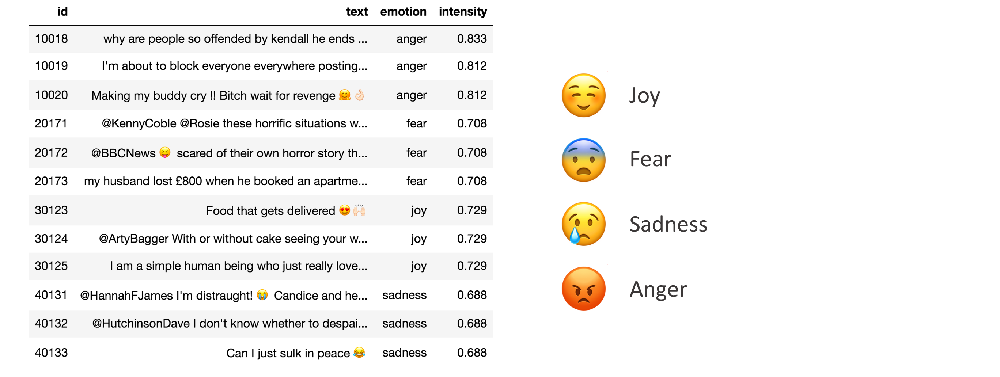

---
## 1. Data Preparation

Before beggining the lab, please make sure to download the [Google News Dataset](https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit) and place it in a folder named "GoogleNews" in the same directory as this file.

## 1.1 Load data

We start by loading the csv files into a single pandas dataframe for training and one for testing.

In [1]:
import pandas as pd

### training data
anger_train = pd.read_csv(
    "data/semeval/train/anger-ratings-0to1.train.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
sadness_train = pd.read_csv(
    "data/semeval/train/sadness-ratings-0to1.train.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
fear_train = pd.read_csv(
    "data/semeval/train/fear-ratings-0to1.train.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
joy_train = pd.read_csv(
    "data/semeval/train/joy-ratings-0to1.train.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)

In [2]:
# combine 4 sub-dataset
train_df = pd.concat(
    [anger_train, fear_train, joy_train, sadness_train], ignore_index=True
)

In [3]:
### testing data
anger_test = pd.read_csv(
    "data/semeval/dev/anger-ratings-0to1.dev.gold.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
sadness_test = pd.read_csv(
    "data/semeval/dev/sadness-ratings-0to1.dev.gold.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
fear_test = pd.read_csv(
    "data/semeval/dev/fear-ratings-0to1.dev.gold.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)
joy_test = pd.read_csv(
    "data/semeval/dev/joy-ratings-0to1.dev.gold.txt",
    sep="\t",
    header=None,
    names=["id", "text", "emotion", "intensity"],
)

# combine 4 sub-dataset
test_df = pd.concat([anger_test, fear_test, joy_test, sadness_test], ignore_index=True)
train_df.head()

,id,text,emotion,intensity
0,10000,How the fu*k! Who the heck! moved my fridge!.....,anger,0.938
1,10001,So my Indian Uber driver just called someone t...,anger,0.896
2,10002,@DPD_UK I asked for my parcel to be delivered ...,anger,0.896
3,10003,so ef whichever butt wipe pulled the fire alar...,anger,0.896
4,10004,Don't join @BTCare they put the phone down on ...,anger,0.896


In [4]:
# shuffle dataset
train_df = train_df.sample(frac=1)
test_df = test_df.sample(frac=1)

In [5]:
print("Shape of Training df: ", train_df.shape)
print("Shape of Testing df: ", test_df.shape)

Shape of Training df:  (3613, 4)
Shape of Testing df:  (347, 4)


---
### ** >>> Exercise 1 (Take home): **  
Plot word frequency for Top 30 words in both train and test dataset. (Hint: refer to DM lab 1)


In [6]:
# Answer here
import nltk

nltk.download("punkt")
nltk.download("punkt_tab")


def tokenizer(text):
    return nltk.word_tokenize(text)

[nltk_data] Downloading package punkt to /home/S113062628/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/S113062628/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


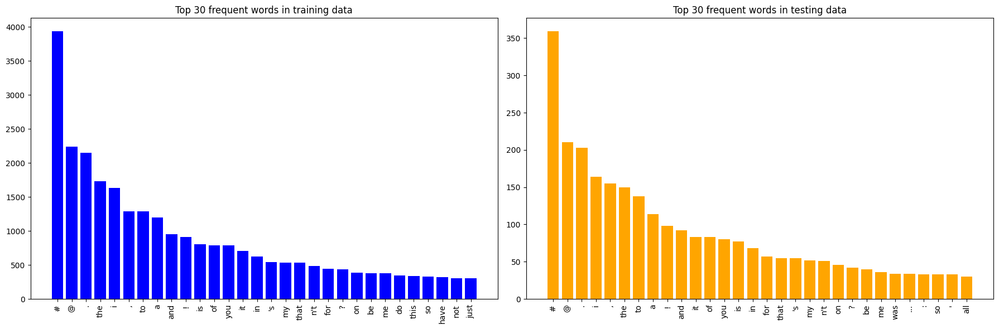

In [7]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
import warnings

warnings.filterwarnings(
    "ignore",
    message="The parameter 'token_pattern' will not be used since 'tokenizer' is not None",
)

count_vect = CountVectorizer(tokenizer=tokenizer)


def file_word_count(file_df):
    return count_vect.fit_transform(file_df["text"])


def word_count(file_df):
    file_count = file_word_count(file_df)
    word_count = np.asarray(file_count.sum(axis=0)).flatten()
    vocab = count_vect.get_feature_names_out()
    word_count_df = pd.DataFrame({"word": vocab, "count": word_count})
    word_count_df = word_count_df.sort_values(by="count", ascending=False).reset_index(
        drop=True
    )
    return word_count_df


train_word_counts = word_count(train_df)
test_word_counts = word_count(test_df)

plt.figure(figsize=(18, 6))
plt.subplot(1, 2, 1)
plt.bar(
    train_word_counts["word"][:30],
    train_word_counts["count"][:30],
    color="blue",
)
plt.xticks(rotation=90)
plt.title("Top 30 frequent words in training data")
plt.subplot(1, 2, 2)
plt.bar(
    test_word_counts["word"][:30],
    test_word_counts["count"][:30],
    color="orange",
)
plt.xticks(rotation=90)
plt.title("Top 30 frequent words in testing data")
plt.tight_layout()
plt.show()

---
### 1.2 Save data

We will save our data in Pickle format. The pickle module implements binary protocols for serializing and de-serializing a Python object structure.   
  
Some advantages for using pickle structure:  
* Because it stores the attribute type, it's more convenient for cross-platform use.  
* When your data is huge, it could use less space to store also consume less loading time.   

In [8]:
## save to pickle file
train_df.to_pickle("train_df.pkl")
test_df.to_pickle("test_df.pkl")

In [9]:
import pandas as pd

## load a pickle file
train_df = pd.read_pickle("train_df.pkl")
test_df = pd.read_pickle("test_df.pkl")

For more information: https://reurl.cc/0Dzqx

---
### 1.3 Exploratory data analysis (EDA)

Again, before getting our hands dirty, we need to explore a little bit and understand the data we're dealing with.

In [10]:
# group to find distribution
train_df.groupby(["emotion"]).count()["text"]

emotion
anger       857
fear       1147
joy         823
sadness     786
Name: text, dtype: int64

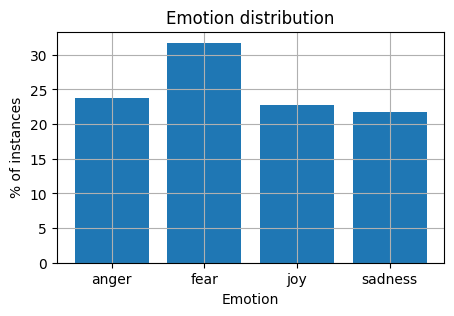

In [11]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

# the histogram of the data
labels = train_df['emotion'].unique()
post_total = len(train_df)
df1 = train_df.groupby(['emotion']).count()['text']
df1 = df1.apply(lambda x: round(x*100/post_total,3))

#plot
fig, ax = plt.subplots(figsize=(5,3))
plt.bar(df1.index,df1.values)

#arrange
plt.ylabel('% of instances')
plt.xlabel('Emotion')
plt.title('Emotion distribution')
plt.grid(True)
plt.show()

---

## 2. Feature engineering
### Using Bag of Words
Using scikit-learn ```CountVectorizer``` perform word frequency and use these as features to train a model.  
http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html

In [12]:
from sklearn.feature_extraction.text import CountVectorizer

In [13]:
# build analyzers (bag-of-words)
BOW_vectorizer = CountVectorizer()

In [14]:
# 1. Learn a vocabulary dictionary of all tokens in the raw documents.
BOW_vectorizer.fit(train_df["text"])

# 2. Transform documents to document-term matrix.
train_data_BOW_features = BOW_vectorizer.transform(train_df["text"])
test_data_BOW_features = BOW_vectorizer.transform(test_df["text"])

In [15]:
# check the result
train_data_BOW_features

<3613x10115 sparse matrix of type '<class 'numpy.int64'>'
	with 51467 stored elements in Compressed Sparse Row format>

In [16]:
type(train_data_BOW_features)

scipy.sparse._csr.csr_matrix

In [17]:
# add .toarray() to show
train_data_BOW_features.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [18]:
# check the dimension
train_data_BOW_features.shape

(3613, 10115)

In [19]:
# observe some feature names
feature_names = BOW_vectorizer.get_feature_names_out()
feature_names[100:110]

array(['2k17', '2much', '2nd', '30', '300', '301', '30am', '30pm', '30s',
       '31'], dtype=object)

The embedding is done. We can technically feed this into our model. However, depending on the embedding technique you use and your model, your accuracy might not be as high, because:

* curse of dimensionality  (we have 10,115 dimension now)
* some important features are ignored (for example, some models using emoticons yeld better performance than counterparts)

In [20]:
"😂" in feature_names

False

Let's try using another tokenizer below.

In [21]:
import nltk

# build analyzers (bag-of-words)
BOW_500 = CountVectorizer(max_features=500, tokenizer=nltk.word_tokenize)

# apply analyzer to training data
BOW_500.fit(train_df["text"])

train_data_BOW_features_500 = BOW_500.transform(train_df["text"])

## check dimension
train_data_BOW_features_500.shape

(3613, 500)

In [22]:
train_data_BOW_features_500.toarray()

array([[0, 1, 0, ..., 0, 0, 0],
       [0, 9, 0, ..., 0, 0, 0],
       [0, 2, 0, ..., 0, 0, 0],
       ...,
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0]])

In [23]:
# observe some feature names
feature_names_500 = BOW_500.get_feature_names_out()
feature_names_500[100:110]

array(['change', 'cheer', 'cheerful', 'cheering', 'cheery', 'come',
       'comes', 'could', 'country', 'cry'], dtype=object)

In [24]:
"😂" in feature_names_500

True

---
### ** >>> Exercise 2 (Take home): **  
Generate an embedding using the TF-IDF vectorizer instead of th BOW one with 1000 features and show the feature names for features [100:110].

In [25]:
# Answer here
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vectorizer = TfidfVectorizer(max_features=1000, tokenizer=tokenizer)
tfidf_matrix = tfidf_vectorizer.fit_transform(train_df["text"])

print(tfidf_vectorizer.get_feature_names_out()[100:110])

['attacks' 'awareness' 'away' 'awe' 'awesome' 'awful' 'b' 'baby' 'back'
 'bad']


---
## 3. Model
### 3.1 Decision Trees
Using scikit-learn ```DecisionTreeClassifier``` performs word frequency and uses these as features to train a model.  
http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html#sklearn.tree.DecisionTreeClassifier

In [26]:
from sklearn.tree import DecisionTreeClassifier

# for a classificaiton problem, you need to provide both training & testing data
X_train = BOW_500.transform(train_df["text"])
y_train = train_df["emotion"]

X_test = BOW_500.transform(test_df["text"])
y_test = test_df["emotion"]

## take a look at data dimension is a good habit  :)
print("X_train.shape: ", X_train.shape)
print("y_train.shape: ", y_train.shape)
print("X_test.shape: ", X_test.shape)
print("y_test.shape: ", y_test.shape)

X_train.shape:  (3613, 500)
y_train.shape:  (3613,)
X_test.shape:  (347, 500)
y_test.shape:  (347,)


In [27]:
## build DecisionTree model
DT_model = DecisionTreeClassifier(random_state=1)

## training!
DT_model = DT_model.fit(X_train, y_train)

## predict!
y_train_pred = DT_model.predict(X_train)
y_test_pred = DT_model.predict(X_test)

## so we get the pred result
y_test_pred[:10]

array(['sadness', 'joy', 'sadness', 'anger', 'fear', 'anger', 'joy',
       'anger', 'anger', 'fear'], dtype=object)

---
## 4. Results Evaluation

Now we will check the results of our model's performance

In [28]:
## accuracy
from sklearn.metrics import accuracy_score

acc_train = accuracy_score(y_true=y_train, y_pred=y_train_pred)
acc_test = accuracy_score(y_true=y_test, y_pred=y_test_pred)

print("training accuracy: {}".format(round(acc_train, 2)))
print("testing accuracy: {}".format(round(acc_test, 2)))

training accuracy: 0.99
testing accuracy: 0.66


In [29]:
## precision, recall, f1-score,
from sklearn.metrics import classification_report

print(classification_report(y_true=y_test, y_pred=y_test_pred))

              precision    recall  f1-score   support

       anger       0.62      0.71      0.67        84
        fear       0.67      0.63      0.65       110
         joy       0.74      0.67      0.70        79
     sadness       0.62      0.64      0.63        74

    accuracy                           0.66       347
   macro avg       0.66      0.66      0.66       347
weighted avg       0.66      0.66      0.66       347



In [30]:
## check by confusion matrix
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred)
print(cm)

[[60 11  7  6]
 [20 69  7 14]
 [ 6 11 53  9]
 [10 12  5 47]]


In [31]:
# Funciton for visualizing confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import itertools


def plot_confusion_matrix(
    cm, classes, title="Confusion matrix", cmap=sns.cubehelix_palette(as_cmap=True)
):
    """
    This function is modified from:
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    classes.sort()
    tick_marks = np.arange(len(classes))

    fig, ax = plt.subplots(figsize=(5, 5))
    im = ax.imshow(cm, interpolation="nearest", cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    ax.set(
        xticks=np.arange(cm.shape[1]),
        yticks=np.arange(cm.shape[0]),
        xticklabels=classes,
        yticklabels=classes,
        title=title,
        xlabel="True label",
        ylabel="Predicted label",
    )

    fmt = "d"
    thresh = cm.max() / 2.0
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(
            j,
            i,
            format(cm[i, j], fmt),
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black",
        )
    ylim_top = len(classes) - 0.5
    plt.ylim([ylim_top, -0.5])
    plt.tight_layout()
    plt.show()

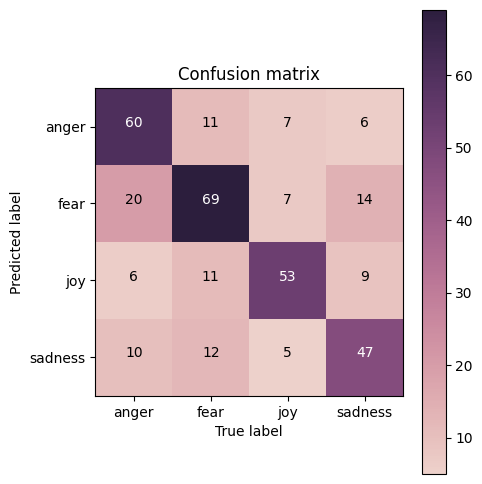

In [32]:
# plot your confusion matrix
my_tags = ["anger", "fear", "joy", "sadness"]
plot_confusion_matrix(cm, classes=my_tags, title="Confusion matrix")

---
### ** >>> Exercise 3 (Take home): **  
Can you interpret the results above? What do they mean?

In [33]:
# Answer here
"""
The confusion matrix displays each pair of predicted and true labels. The 
diagonal elements represent correct predictions for each class, while the 
off-diagonal elements indicate misclassifications. For instance, the cell in 
the second row and first column shows how many times the model misclassified 
instances of 'fear' as 'anger.' Similarly, the cell in the third row and fourth 
column shows the number of times 'joy' was misclassified as 'sadness.' Each 
off-diagonal cell helps identify specific pairs of emotions that the model 
finds challenging to distinguish.
"""

"\nThe confusion matrix displays each pair of predicted and true labels. The \ndiagonal elements represent correct predictions for each class, while the \noff-diagonal elements indicate misclassifications. For instance, the cell in \nthe second row and first column shows how many times the model misclassified \ninstances of 'fear' as 'anger.' Similarly, the cell in the third row and fourth \ncolumn shows the number of times 'joy' was misclassified as 'sadness.' Each \noff-diagonal cell helps identify specific pairs of emotions that the model \nfinds challenging to distinguish.\n"

---
### ** >>> Exercise 4 (Take home): **  
Build a model using a ```Naive Bayes``` model and train it. What are the testing results? 

*Reference*: https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.MultinomialNB.html

In [34]:
# Answer here
from sklearn.naive_bayes import MultinomialNB

nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)

y_pred = nb_classifier.predict(X_test)

print("Accuracy: ", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=my_tags, digits=4))

Accuracy:  0.7089337175792507
              precision    recall  f1-score   support

       anger     0.6512    0.6667    0.6588        84
        fear     0.7417    0.8091    0.7739       110
         joy     0.7746    0.6962    0.7333        79
     sadness     0.6571    0.6216    0.6389        74

    accuracy                         0.7089       347
   macro avg     0.7062    0.6984    0.7012       347
weighted avg     0.7092    0.7089    0.7080       347



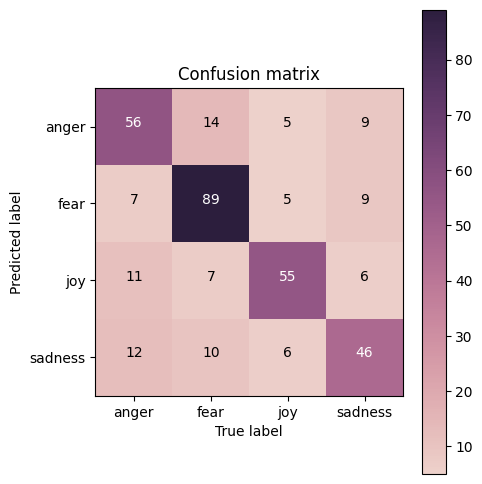

In [35]:
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)
plot_confusion_matrix(cm, classes=my_tags, title="Confusion matrix")

---
### ** >>> Exercise 5 (Take home): **  

How do the results from the Naive Bayes model and the Decision Tree model compare? How do you interpret these differences? Use the theoretical background covered in class to try and explain these differences.

In [36]:
# Answer here
"""
The fear to fear prediction is higher than the previous model, but the 
overall accuracy doesn't improve a lot. The Naive Bayes model, assuming feature 
independence, performs well in generalizing across classes, making it effective 
for text classification but prone to confusion between closely related emotions 
like "fear" and "sadness." In contrast, the Decision Tree model captures
complex patterns by considering feature interactions, which helps it 
distinguish nuanced emotions but also makes it more susceptible to 
overfitting, potentially reducing its accuracy on new data.
"""

'\nThe fear to fear prediction is higher than the previous model, but the \noverall accuracy doesn\'t improve a lot. The Naive Bayes model, assuming feature \nindependence, performs well in generalizing across classes, making it effective \nfor text classification but prone to confusion between closely related emotions \nlike "fear" and "sadness." In contrast, the Decision Tree model captures\ncomplex patterns by considering feature interactions, which helps it \ndistinguish nuanced emotions but also makes it more susceptible to \noverfitting, potentially reducing its accuracy on new data.\n'

---

## 5. Other things you can try

Thus, there are several things you can try that will affect your results. In order to yield better results, you can experiment by: 
- Trying different features (Feature engineering)e.g Word2Vec, PCA, LDA, FastText, Clustering
- Trying different models
- Analyzing your results and interpret them to improve your feature engineering/model building process
- Iterate through the steps above until finding a satisfying result

Remember that you should also consider the task at hand and the model you'll feed the data to. 

---
## 6. Deep Learning

We use [Keras](https://keras.io/) to be our deep learning framework, and follow the [Model (functional API)](https://keras.io/models/model/) to build a Deep Neural Network (DNN) model. Keras runs with Tensorflow in the backend. It's a nice abstraction to start working with NN models. 

Because Deep Learning is a 1-semester course, we can't talk about each detail about it in the lab session. Here, we only provide a simple template about how to build & run a DL model successfully. You can follow this template to design your model.

We will begin by building a fully connected network, which looks like this:

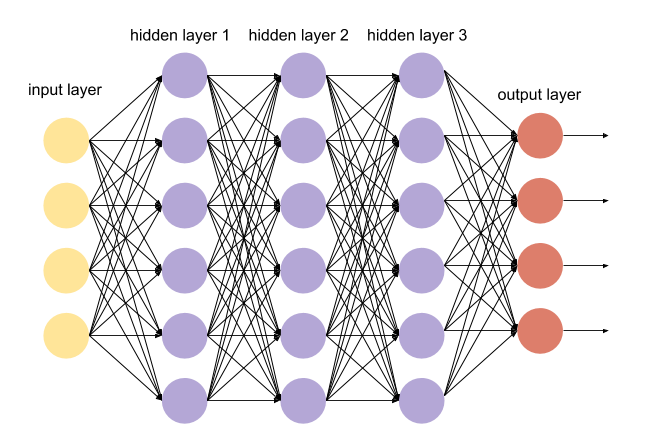

(source: https://github.com/drewnoff/spark-notebook-ml-labs/tree/master/labs/DLFramework)


### 6.1 Prepare data (X, y)

In [37]:
import keras

# standardize name (X, y)
X_train = BOW_500.transform(train_df["text"])
y_train = train_df["emotion"]

X_test = BOW_500.transform(test_df["text"])
y_test = test_df["emotion"]

## check dimension is a good habbit
print("X_train.shape: ", X_train.shape)
print("y_train.shape: ", y_train.shape)
print("X_test.shape: ", X_test.shape)
print("y_test.shape: ", y_test.shape)

2024-11-13 20:23:08.916644: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-13 20:23:08.921622: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-13 20:23:08.933339: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1731500588.956152   32103 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1731500588.962824   32103 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-13 20:23:08.988926: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

X_train.shape:  (3613, 500)
y_train.shape:  (3613,)
X_test.shape:  (347, 500)
y_test.shape:  (347,)


In [38]:
import keras

In [39]:
BOW_500.transform(test_df["text"])

<347x500 sparse matrix of type '<class 'numpy.int64'>'
	with 4103 stored elements in Compressed Sparse Row format>

### 6.2 Deal with categorical label (y)

Rather than put your label `train_df['emotion']` directly into a model, we have to process these categorical (or say nominal) label by ourselves. 

Here, we use the basic method [one-hot encoding](https://en.wikipedia.org/wiki/One-hot) to transform our categorical  labels to numerical ones.


In [40]:
## deal with label (string -> one-hot)

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
label_encoder.fit(y_train)
print("check label: ", label_encoder.classes_)
print("\n## Before convert")
print("y_train[0:4]:\n", y_train[0:4])
print("\ny_train.shape: ", y_train.shape)
print("y_test.shape: ", y_test.shape)


def label_encode(le, labels):
    enc = le.transform(labels)
    return keras.utils.to_categorical(enc)


def label_decode(le, one_hot_label):
    dec = np.argmax(one_hot_label, axis=1)
    return le.inverse_transform(dec)


y_train = label_encode(label_encoder, y_train)
y_test = label_encode(label_encoder, y_test)

print("\n\n## After convert")
print("y_train[0:4]:\n", y_train[0:4])
print("\ny_train.shape: ", y_train.shape)
print("y_test.shape: ", y_test.shape)

check label:  ['anger' 'fear' 'joy' 'sadness']

## Before convert
y_train[0:4]:
 2411        joy
3448    sadness
2115        joy
1233       fear
Name: emotion, dtype: object

y_train.shape:  (3613,)
y_test.shape:  (347,)


## After convert
y_train[0:4]:
 [[0. 0. 1. 0.]
 [0. 0. 0. 1.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]]

y_train.shape:  (3613, 4)
y_test.shape:  (347, 4)


### 6.3 Build model

In [41]:
# I/O check
input_shape = X_train.shape[1]
print("input_shape: ", input_shape)

output_shape = len(label_encoder.classes_)
print("output_shape: ", output_shape)

input_shape:  500
output_shape:  4


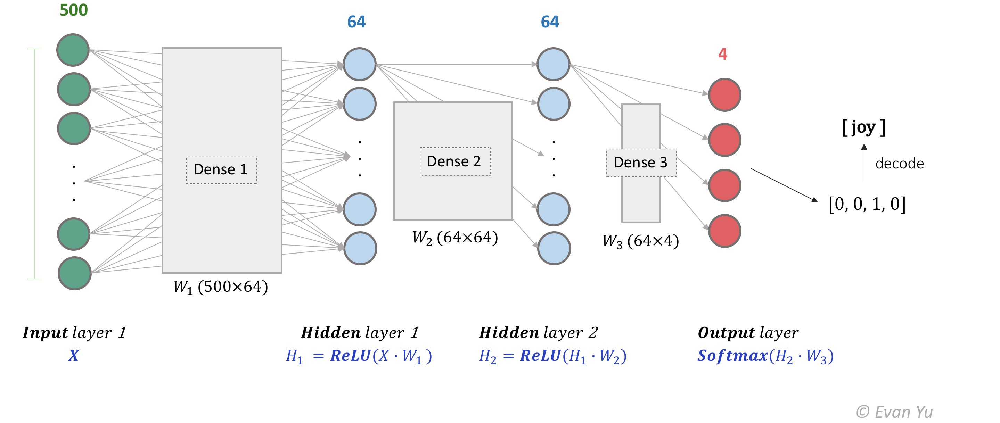

In [42]:
from keras.models import Model
from keras.layers import Input, Dense
from keras.layers import ReLU, Softmax

# input layer
model_input = Input(shape=(input_shape,))  # 500
X = model_input

# 1st hidden layer
X_W1 = Dense(units=64)(X)  # 64
H1 = ReLU()(X_W1)

# 2nd hidden layer
H1_W2 = Dense(units=64)(H1)  # 64
H2 = ReLU()(H1_W2)

# output layer
H2_W3 = Dense(units=output_shape)(H2)  # 4
H3 = Softmax()(H2_W3)

model_output = H3

# create model
model = Model(inputs=[model_input], outputs=[model_output])

# loss function & optimizer
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

# show model construction
model.summary()

W0000 00:00:1731500591.388040   32103 gpu_device.cc:2344] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 500)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │        32,064 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 4)              │           260 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ softmax (Softmax)               │ (None, 4)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,484 (142.52 KB)

 Trainable params: 36,484 (142.52 KB)

 Non-trainable params: 0 (0.00 B)

### 6.4 Train

In [43]:
from keras.callbacks import CSVLogger

csv_logger = CSVLogger("logs/training_log.csv")

# training setting
epochs = 25
batch_size = 32

# training!
history = model.fit(
    X_train,
    y_train,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[csv_logger],
    validation_data=(X_test, y_test),
)
print("training finish")

Epoch 1/25


/home/S113062628/micromamba/envs/dm_lab_2/lib/python3.12/site-packages/keras/src/models/functional.py:225: UserWarning: The structure of `inputs` doesn't match the expected structure: ['keras_tensor']. Received: the structure of inputs=*
  warnings.warn(


113/113 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.3273 - loss: 1.3596 - val_accuracy: 0.4841 - val_loss: 1.2579
Epoch 2/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6090 - loss: 1.0761 - val_accuracy: 0.6484 - val_loss: 0.8978
Epoch 3/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8080 - loss: 0.5876 - val_accuracy: 0.7032 - val_loss: 0.7592
Epoch 4/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8726 - loss: 0.3851 - val_accuracy: 0.6859 - val_loss: 0.7491
Epoch 5/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9019 - loss: 0.2988 - val_accuracy: 0.6945 - val_loss: 0.7916
Epoch 6/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9208 - loss: 0.2401 - val_accuracy: 0.6916 - val_loss: 0.8357
Epoch 7/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9439 - loss: 0.1983 - val_accuracy: 0.6772 - val_loss: 0.9020
Epoch 8/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9536 - loss: 0.1544 - val_accuracy: 0.6772 - val_

### 6.5 Predict on testing data

In [44]:
## predict
pred_result = model.predict(X_test, batch_size=128)
pred_result[:5]

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


array([[1.1192442e-05, 2.6592003e-02, 8.8896634e-08, 9.7339660e-01],
       [2.1825561e-07, 3.6087025e-05, 9.9996358e-01, 1.9529438e-08],
       [3.4036711e-06, 6.1960057e-03, 7.1658707e-07, 9.9379981e-01],
       [1.7684822e-01, 1.4009297e-01, 2.6406448e-03, 6.8041813e-01],
       [1.3796663e-05, 9.9997622e-01, 6.3342287e-10, 9.9248709e-06]],
      dtype=float32)

In [45]:
pred_result = label_decode(label_encoder, pred_result)
pred_result[:5]

array(['sadness', 'joy', 'sadness', 'sadness', 'fear'], dtype=object)

In [46]:
from sklearn.metrics import accuracy_score

print(
    "testing accuracy: {}".format(
        round(accuracy_score(label_decode(label_encoder, y_test), pred_result), 2)
    )
)

testing accuracy: 0.67


In [47]:
# Let's take a look at the training log
training_log = pd.DataFrame()
training_log = pd.read_csv("logs/training_log.csv")
training_log

,epoch,accuracy,loss,val_accuracy,val_loss
0,0,0.378633,1.327277,0.484150,1.257919
1,1,0.656518,0.969381,0.648415,0.897850
2,2,0.805148,0.570371,0.703170,0.759170
3,3,0.858013,0.398466,0.685879,0.749100
4,4,0.896485,0.306337,0.694524,0.791557
5,5,0.912261,0.251022,0.691643,0.835711
6,6,0.930805,0.209214,0.677233,0.901956
7,7,0.947135,0.168708,0.677233,0.954422
8,8,0.955992,0.149188,0.668588,1.005641
9,9,0.960697,0.130899,0.677233,1.061043


---
### ** >>> Exercise 6 (Take home): **  

Plot the Training and Validation Accuracy and Loss (different plots), just like the images below.(Note: the pictures below are an example from a different model). How to interpret the graphs you got? How are they related to the concept of overfitting/underfitting covered in class?

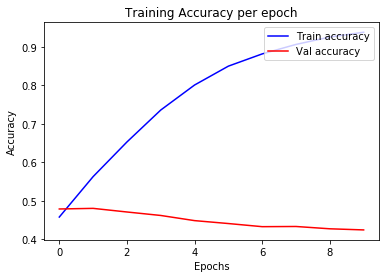


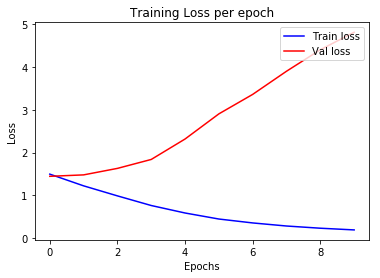

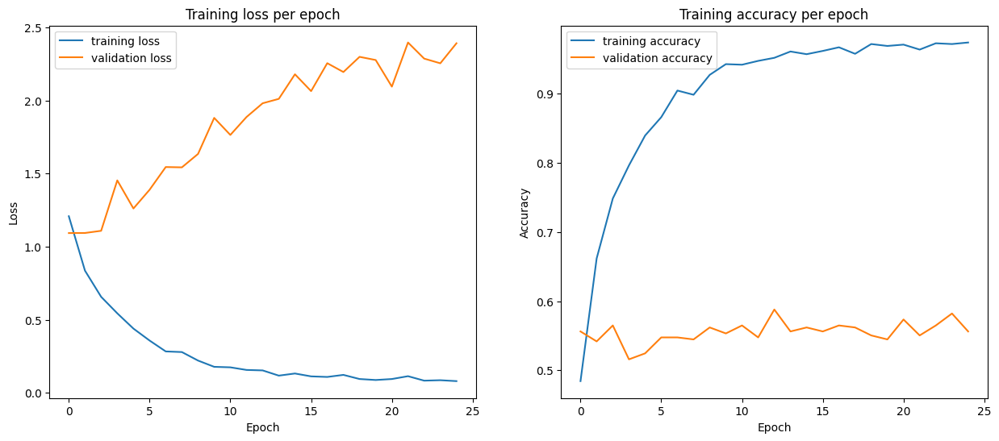

In [122]:
# Answer here
import matplotlib.pyplot as plt


def plot_training_logs(training_log):

    plt.figure(figsize=(15, 6))

    # Plotting loss
    plt.subplot(1, 2, 1)
    plt.plot(training_log["loss"], label="training loss")
    plt.plot(training_log["val_loss"], label="validation loss")
    plt.title("Training loss per epoch")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    # Plotting accuracy
    plt.subplot(1, 2, 2)
    plt.plot(training_log["accuracy"], label="training accuracy")
    plt.plot(training_log["val_accuracy"], label="validation accuracy")
    plt.title("Training accuracy per epoch")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()

    plt.show()


plot_training_logs(training_log)

---

### Note

If you don't have a GPU (level is higher than GTX 1060) or you are not good at setting lots of things about computer, we recommend you to use the [kaggle kernel](https://www.kaggle.com/kernels) to do deep learning model training. They have already installed all the librarys and provided free GPU for you to use.

Note however that you will only be able to run a kernel for 6 hours. After 6 hours of inactivity, your Kaggle kernel will shut down (meaning if your model takes more than 6 hours to train, you can't train it at once).


### More Information for your reference

* Keras document: https://keras.io/
* Keras GitHub example: https://github.com/keras-team/keras/tree/master/examples
* CS229: Machine Learning: http://cs229.stanford.edu/syllabus.html
* Deep Learning cheatsheet: https://stanford.edu/~shervine/teaching/cs-229/cheatsheet-deep-learning
* If you want to try TensorFlow or PyTorch: https://pytorch.org/tutorials/
https://www.tensorflow.org/tutorials/quickstart/beginner

---
## 7. Word2Vector

We will introduce how to use `gensim` to train your word2vec model and how to load a pre-trained model.

https://radimrehurek.com/gensim/index.html

### 7.1 Prepare training corpus

In [53]:
## check library
import gensim

## ignore warnings
import warnings

warnings.filterwarnings("ignore")

# # if you want to see the training messages, you can use it
# import logging
# logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

## the input type
train_df["text_tokenized"] = train_df["text"].apply(lambda x: nltk.word_tokenize(x))
train_df[["id", "text", "text_tokenized"]].head()

,id,text,text_tokenized
2411,30407,Watch this amazing live.ly broadcast by @ittzd...,"[Watch, this, amazing, live.ly, broadcast, by,..."
3448,40621,Jay Z and Brad Pitt cheated ..Bey stayed Angie...,"[Jay, Z, and, Brad, Pitt, cheated, .., Bey, st..."
2115,30111,"What a great training course, lots of photos, ...","[What, a, great, training, course, ,, lots, of..."
1233,20376,Appropriate that first secretary at permanent ...,"[Appropriate, that, first, secretary, at, perm..."
628,10628,"@ToddDoug @Ziggomattic Yeah, this actually sup...","[@, ToddDoug, @, Ziggomattic, Yeah, ,, this, a..."


In [54]:
## create the training corpus
training_corpus = train_df["text_tokenized"].values
training_corpus[:3]

array([list(['Watch', 'this', 'amazing', 'live.ly', 'broadcast', 'by', '@', 'ittzdevin', '#', 'musically']),
       list(['Jay', 'Z', 'and', 'Brad', 'Pitt', 'cheated', '..', 'Bey', 'stayed', 'Angie', 'left', '#', 'cheaters', '#', 'love', '#', 'lust', '#', 'sex', '#', 'couples', '#', 'relationships', '#', 'date', '#', 'marriage', '#', 'divorce']),
       list(['What', 'a', 'great', 'training', 'course', ',', 'lots', 'of', 'photos', ',', 'fun', 'and', 'laughter', '.', 'Photo', "'s", 'will', 'be', 'up', 'soon', '#', 'Boostercourse', '#', 'fun'])],
      dtype=object)

### 7.2 Training our model

You can try to train your own model. More details: https://radimrehurek.com/gensim/models/word2vec.html

In [55]:
from gensim.models import Word2Vec

## setting
vector_dim = 100
window_size = 5
min_count = 1
training_epochs = 20

## model
word2vec_model = Word2Vec(
    sentences=training_corpus,
    vector_size=vector_dim,
    window=window_size,
    min_count=min_count,
    epochs=training_epochs,
)

![Imgur](https://i.imgur.com/Fca3MCs.png)

### 7.3 Generating word vector (embeddings)

In [56]:
# get the corresponding vector of a word
word_vec = word2vec_model.wv["happy"]
word_vec

array([ 0.27489185,  0.20847465, -0.39823547,  0.25074866,  0.04055525,
       -1.0036216 ,  0.5541547 ,  1.4903195 , -0.737735  , -0.3493402 ,
       -0.33476692, -0.6557313 , -0.10675036, -0.03226342, -0.23063837,
       -0.131022  ,  0.25141162, -0.3118658 ,  0.60468113, -1.3590192 ,
        0.6278696 ,  0.7646503 ,  0.49770156, -0.20507358,  0.18760209,
       -0.16660559, -0.47204775,  0.03364458, -0.5732215 ,  0.20363598,
        0.03835035, -0.14508873,  0.708385  , -0.6347761 , -0.01416621,
        0.75939775,  0.08020408,  0.29746586, -0.70394623, -0.28016835,
        0.1942775 ,  0.0052572 , -0.1181959 , -0.0397857 ,  0.5812227 ,
       -0.61228234, -0.49604243,  0.47993666,  0.56128615,  0.50287443,
        0.00592232, -0.2792468 , -0.09762607,  0.34043834, -0.6753277 ,
       -0.5738643 ,  0.06927042, -0.38427222,  0.19807911,  0.3617186 ,
        0.10159346, -0.06469626,  0.45948884,  0.50076765, -0.70326805,
        0.8993221 ,  0.5309138 ,  0.34073344, -1.2231811 ,  0.51

In [57]:
# Get the most similar words
word = "happy"
topn = 10
word2vec_model.wv.most_similar(word, topn=topn)

[('cats', 0.9242408275604248),
 ('free', 0.917503297328949),
 ('help', 0.9031294584274292),
 ('plz', 0.8997978568077087),
 ('bday', 0.8995227217674255),
 ('happier', 0.8968368768692017),
 ('.\\nA', 0.8956922888755798),
 ('dad', 0.8926113247871399),
 ('Please', 0.8907777070999146),
 ('birthday', 0.8901258707046509)]

### 7.4 Using a pre-trained w2v model

Instead of training your own model ,you can use a model that has already been trained. Here, we see 2 ways of doing that:


#### (1) Download model by yourself

source: [GoogleNews-vectors-negative300](https://code.google.com/archive/p/word2vec/)

more details: https://radimrehurek.com/gensim/models/keyedvectors.html

In [60]:
from gensim.models import KeyedVectors

## Note: this model is very huge, this will take some time ...
model_path = "GoogleNews/GoogleNews-vectors-negative300.bin.gz"
w2v_google_model = KeyedVectors.load_word2vec_format(model_path, binary=True)
print("load ok")

w2v_google_model.most_similar("happy", topn=10)

load ok


[('glad', 0.7408890724182129),
 ('pleased', 0.6632170677185059),
 ('ecstatic', 0.6626912355422974),
 ('overjoyed', 0.6599286794662476),
 ('thrilled', 0.6514049172401428),
 ('satisfied', 0.6437949538230896),
 ('proud', 0.636042058467865),
 ('delighted', 0.627237856388092),
 ('disappointed', 0.6269949674606323),
 ('excited', 0.6247665286064148)]

#### (2) Using gensim api

Other pretrained models are available here: https://github.com/RaRe-Technologies/gensim-data

In [61]:
import gensim.downloader as api

## If you see `SSL: CERTIFICATE_VERIFY_FAILED` error, use this:
import ssl
import urllib.request

ssl._create_default_https_context = ssl._create_unverified_context

glove_twitter_25_model = api.load("glove-twitter-25")
print("load ok")

glove_twitter_25_model.most_similar("happy", topn=10)

[==================================================] 100.0% 104.8/104.8MB downloaded
load ok


[('birthday', 0.9577818512916565),
 ('thank', 0.937666654586792),
 ('welcome', 0.93361496925354),
 ('love', 0.9176183342933655),
 ('miss', 0.9164500832557678),
 ('hello', 0.9158351421356201),
 ('thanks', 0.915008544921875),
 ('merry', 0.9053249359130859),
 ('bless', 0.902732253074646),
 ('wish', 0.9013164043426514)]

### 7.5 king + woman - man = ?

Let's run one of the most famous examples for Word2Vec and compute the similarity between these 3 words:

In [62]:
w2v_google_model.most_similar(positive=["king", "woman"], negative=["man"])

[('queen', 0.7118193507194519),
 ('monarch', 0.6189674139022827),
 ('princess', 0.5902431011199951),
 ('crown_prince', 0.5499460697174072),
 ('prince', 0.5377321839332581),
 ('kings', 0.5236844420433044),
 ('Queen_Consort', 0.5235945582389832),
 ('queens', 0.5181134343147278),
 ('sultan', 0.5098593831062317),
 ('monarchy', 0.5087411999702454)]

---
### ** >>> Exercise 7 (Take home): **  

Now, we have the word vectors, but our input data is a sequence of words (or say sentence). 
How can we utilize these "word" vectors to represent the sentence data and train our model?


In [ ]:
# Answer here
"""
We can add up the vectors to represent the sentence embedding, and use it to train the model.
"""

## 8. Clustering: k-means

Here we introduce how to use `sklearn` to do the basic **unsupervised learning** approach, k-means.    

more details: http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html


#### Basic concept

![Image](https://i.imgur.com/PEdUf54.png)

(img source: https://towardsdatascience.com/k-means-clustering-identifying-f-r-i-e-n-d-s-in-the-world-of-strangers-695537505d)

In [63]:
# clustering target
target_list = ["happy", "fear", "angry", "car", "teacher", "computer"]
print("target words: ", target_list)

# convert to word vector
X = [word2vec_model.wv[word] for word in target_list]

target words:  ['happy', 'fear', 'angry', 'car', 'teacher', 'computer']


In [64]:
from sklearn.cluster import KMeans

# we have to decide how many cluster (k) we want
k = 2

# k-means model
kmeans_model = KMeans(n_clusters=k)
kmeans_model.fit(X)

# cluster result
cluster_result = kmeans_model.labels_

# show
for i in range(len(target_list)):
    print("word: {} \t cluster: {}".format(target_list[i], cluster_result[i]))

word: happy 	 cluster: 0
word: fear 	 cluster: 1
word: angry 	 cluster: 1
word: car 	 cluster: 1
word: teacher 	 cluster: 1
word: computer 	 cluster: 1


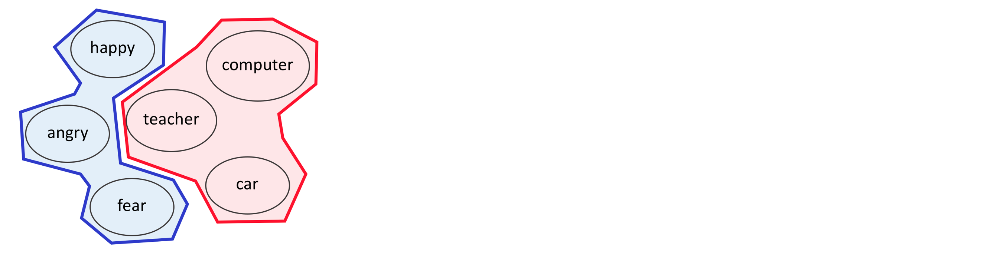

In [65]:
# check cluster membership
word = "student"
word_vec = word2vec_model.wv[word]
kmeans_model.predict([word_vec])

array([1], dtype=int32)

In [66]:
# check cluster membership
word = "sad"
word_vec = word2vec_model.wv[word]
kmeans_model.predict([word_vec])

array([0], dtype=int32)


## 9. High-dimension Visualization: t-SNE and UMAP

No matter if you use the Bag-of-words, TF-IDF, or Word2Vec, it's very hard to see the embedding result, because the dimension is larger than 3.  

In Lab 1, we already talked about PCA, t-SNE and UMAP. We can use PCA to reduce the dimension of our data, then visualize it. However, if you dig deeper into the result, you'd find it is insufficient.

Our aim will be to create a visualization similar to the one below with t-SNE:

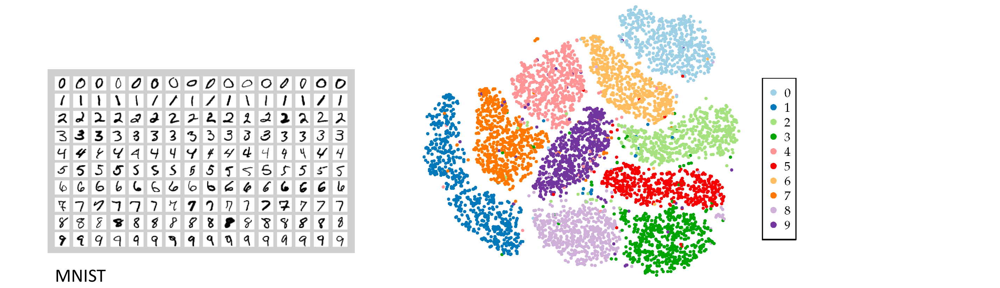

source: https://www.fabian-keller.de/research/high-dimensional-data-visualization 

And also like this for UMAP:
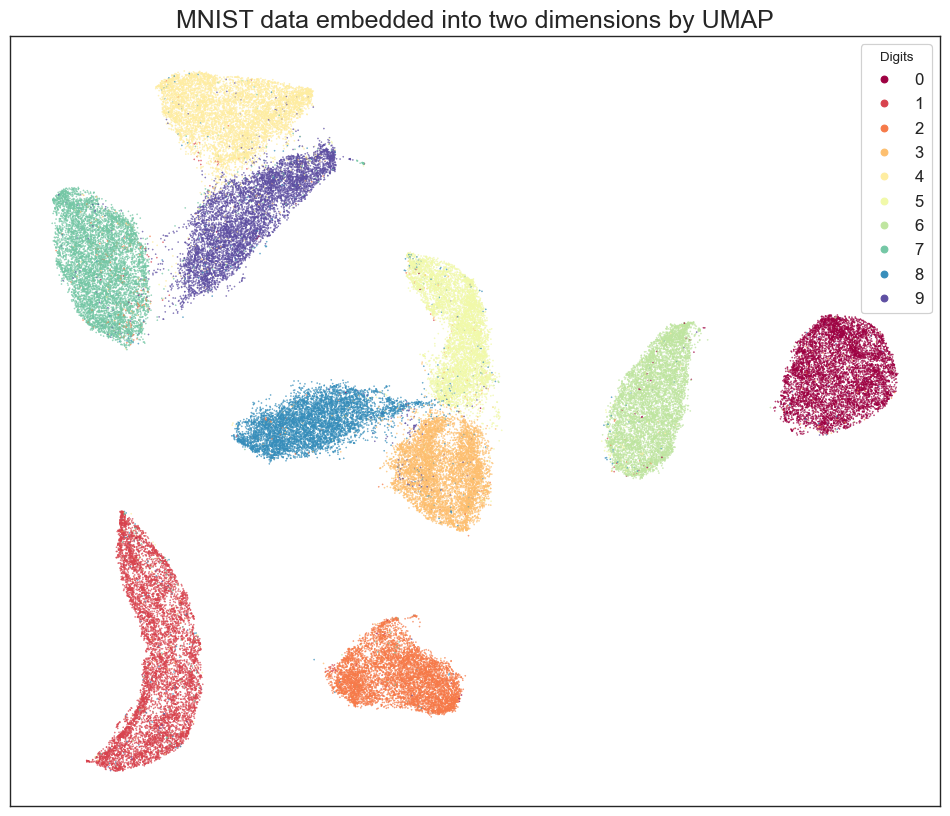

source: https://umap-learn.readthedocs.io/en/latest/auto_examples/plot_mnist_example.html

t-SNE and UMAP reference:  
http://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html 
https://umap-learn.readthedocs.io/en/latest/

### 9.1 Prepare visualizing target

Let's prepare data lists like:
- happy words
- angry words
- data words
- mining words

In [67]:
word_list = ["happy", "angry", "data", "mining"]

topn = 5
happy_words = ["happy"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("happy", topn=topn)
]
angry_words = ["angry"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("angry", topn=topn)
]
data_words = ["data"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("data", topn=topn)
]
mining_words = ["mining"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("mining", topn=topn)
]

print("happy_words: ", happy_words)
print("angry_words: ", angry_words)
print("data_words: ", data_words)
print("mining_words: ", mining_words)

target_words = happy_words + angry_words + data_words + mining_words
print("\ntarget words: ")
print(target_words)

print("\ncolor list:")
cn = topn + 1
color = ["b"] * cn + ["g"] * cn + ["r"] * cn + ["y"] * cn
print(color)

happy_words:  ['happy', 'glad', 'pleased', 'ecstatic', 'overjoyed', 'thrilled']
angry_words:  ['angry', 'irate', 'enraged', 'indignant', 'incensed', 'annoyed']
data_words:  ['data', 'Data', 'datasets', 'dataset', 'databases', 'statistics']
mining_words:  ['mining', 'Mining', 'mines', 'coal_mining', 'mine', 'miner']

target words: 
['happy', 'glad', 'pleased', 'ecstatic', 'overjoyed', 'thrilled', 'angry', 'irate', 'enraged', 'indignant', 'incensed', 'annoyed', 'data', 'Data', 'datasets', 'dataset', 'databases', 'statistics', 'mining', 'Mining', 'mines', 'coal_mining', 'mine', 'miner']

color list:
['b', 'b', 'b', 'b', 'b', 'b', 'g', 'g', 'g', 'g', 'g', 'g', 'r', 'r', 'r', 'r', 'r', 'r', 'y', 'y', 'y', 'y', 'y', 'y']


### 9.2 Plot using t-SNE and UMAP (2-dimension)

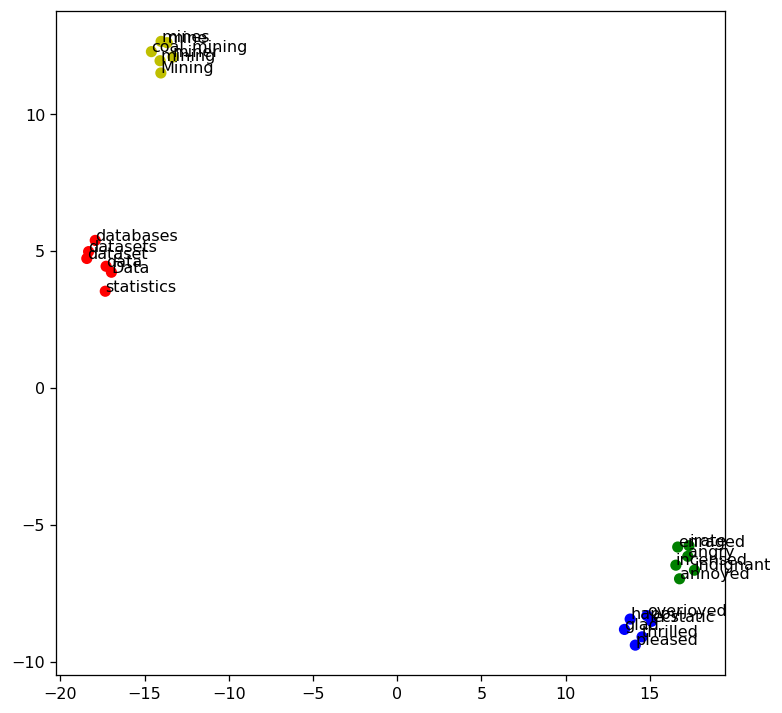

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

## w2v model
model = w2v_google_model

## prepare training word vectors
size = 200
target_size = len(target_words)
all_word = list(model.index_to_key)
word_train = target_words + all_word[:size]
X_train = model[word_train]

## t-SNE model
tsne = TSNE(n_components=2, metric='cosine', random_state=28)

## training
X_tsne = tsne.fit_transform(X_train)

## plot the result
plt.figure(figsize=(7.5, 7.5), dpi=115)
plt.scatter(X_tsne[:target_size, 0], X_tsne[:target_size, 1], c=color)
for label, x, y in zip(target_words, X_tsne[:target_size, 0], X_tsne[:target_size, 1]):
    plt.annotate(label, xy=(x,y), xytext=(0,0),  textcoords='offset points')
plt.show()

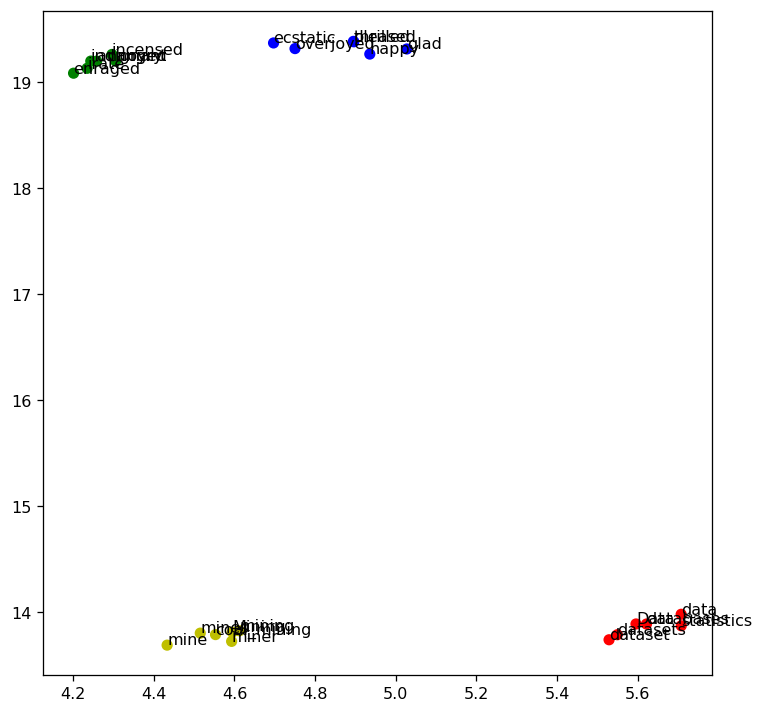

In [69]:
import matplotlib.pyplot as plt
import umap.umap_ as umap

## w2v model
model = w2v_google_model

## prepare training word vectors
size = 200
target_size = len(target_words)
all_word = list(model.index_to_key)
word_train = target_words + all_word[:size]
X_train = model[word_train]

## UMAP model
umap_model = umap.UMAP(n_components=2, metric="cosine", random_state=28)

## training
X_umap = umap_model.fit_transform(X_train)

## plot the result
plt.figure(figsize=(7.5, 7.5), dpi=115)
plt.scatter(X_umap[:target_size, 0], X_umap[:target_size, 1], c=color)
for label, x, y in zip(target_words, X_umap[:target_size, 0], X_umap[:target_size, 1]):
    plt.annotate(label, xy=(x, y), xytext=(0, 0), textcoords="offset points")
plt.show()


### ** >>> Exercise 8 (Take home): **  

Generate a t-SNE and UMAP visualization to show the 15 words most related to the words "angry", "happy", "sad", "fear" (60 words total). Compare the differences between both graphs.

Text(0.5, 1.0, 'UMAP')

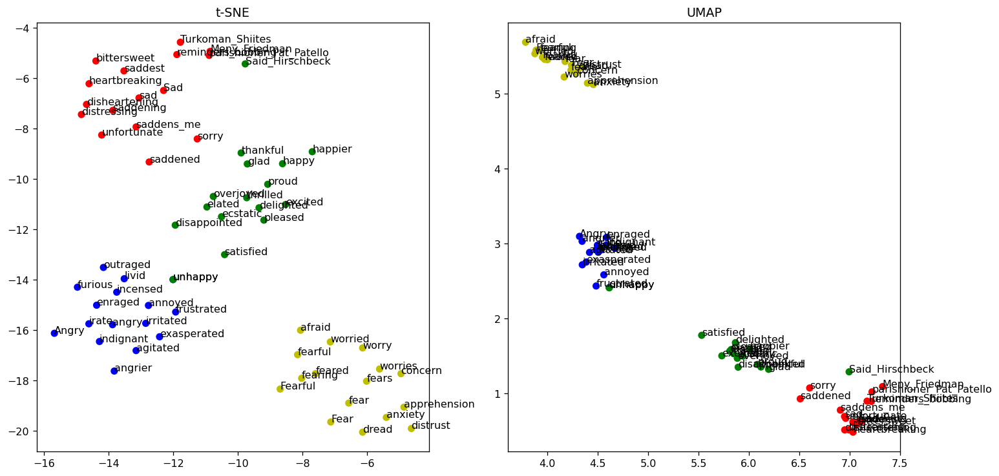

In [72]:
# Answer here
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import umap.umap_ as umap

word_list = ["angry", "happy", "sad", "fear"]

topn = 15
angry_words = ["angry"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("angry", topn=topn)
]
happy_words = ["happy"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("happy", topn=topn)
]

sad_words = ["sad"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("sad", topn=topn)
]
fear_words = ["fear"] + [
    word_ for word_, sim_ in w2v_google_model.most_similar("fear", topn=topn)
]

target_words = angry_words + happy_words + sad_words + fear_words

model = w2v_google_model
umap_model = umap.UMAP(n_components=2, metric="cosine", random_state=28)

size = 200
target_size = len(target_words)
all_word = list(model.index_to_key)
word_train = target_words + all_word[:size]
X_train = model[word_train]

tsne = TSNE(n_components=2, metric="cosine", random_state=28)

X_tsne = tsne.fit_transform(X_train)
X_umap = umap_model.fit_transform(X_train)

fig, axes = plt.subplots(1, 2, figsize=(15, 7.5), dpi=115)

axes[0].scatter(X_tsne[:target_size, 0], X_tsne[:target_size, 1], c=color)
for label, x, y in zip(target_words, X_tsne[:target_size, 0], X_tsne[:target_size, 1]):
    axes[0].annotate(label, xy=(x, y), xytext=(0, 0), textcoords="offset points")
axes[0].set_title("t-SNE")

axes[1].scatter(X_umap[:target_size, 0], X_umap[:target_size, 1], c=color)
for label, x, y in zip(target_words, X_umap[:target_size, 0], X_umap[:target_size, 1]):
    axes[1].annotate(label, xy=(x, y), xytext=(0, 0), textcoords="offset points")
axes[1].set_title("UMAP")

## 10. Large Language Models (LLMs)
Large Language Models (LLMs) are AI models trained on vast text data to understand and generate human language. Models like GPT and BERT excel at tasks like translation, summarization, and sentiment analysis due to their deep learning techniques and large-scale training. Recently these models got popular with the rise of Open-AI's ChatGPT and their different models, showcasing the potential of these models in a lot of aspects of our current society.

Open-source LLMs are cost-effective and customizable, with strong community support, but may underperform compared to paid models and require technical expertise to manage. Paid LLMs offer superior performance, ease of use, and regular updates, but are costly, less flexible, and create dependency on external providers for ongoing access and updates.

#### Open Source LLMs: 
In this lab we are going to use Ollama ([Ollama GitHub Link](https://github.com/ollama/ollama)), that is a library that let us use a long list of open-source LLMs of differing size. For this section we are going to be using **'llama3.2'** or **'llama3.2:1b'** for **text based tasks**, and **'llava-phi3'** for **multi-modal tasks** (e.g. image to text). Ollama has a great variety of models, and those can be found here: [model library](https://ollama.com/library). You are free to explore them if you want to try using them, you can check the advantages and disadvantages of each.

Or they can also be observed in here:
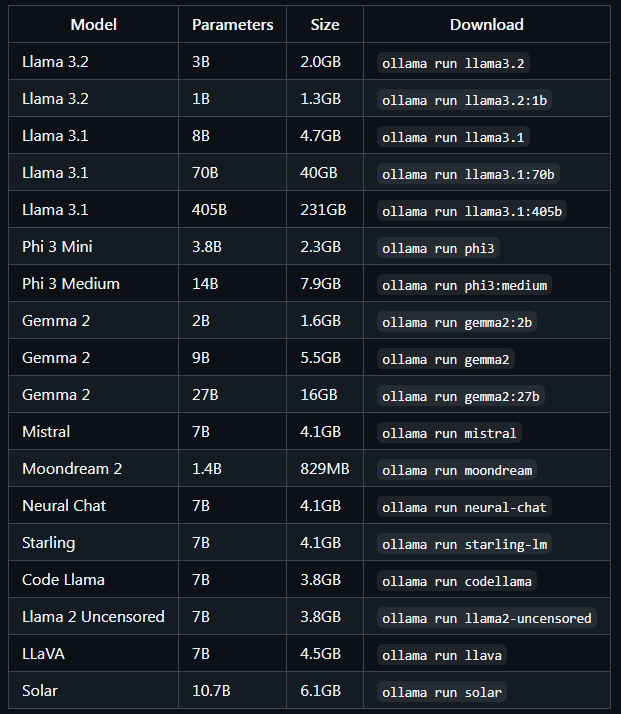

In the previous image we can observe that all LLMs have something called parameters, these are the internal weights that the model learns during training, helping it understand and generate language. The more a model has, the more complex and accurate it can be, but it also needs more memory to run.

For example:

Models with **7 billion parameters** need at least **8 GB of VRAM**.
**13 billion parameters** require **16 GB of VRAM**.
**33 billion parameters** need **32 GB of VRAM**.
The higher the number of parameters, the more memory and computational power the model needs to function efficiently.

And so that is why we are trying to use small LLMs for this practice, because they require a lot of computational resources, so by using 'llama3.2' and 'llava-phi3', both models with 3 billion parameters, we will only use at most 8 GB of VRAM. But if there are some issues with 'llama3.2' we can still use 'llama3.2:1b' the model with 1 billion parameters that requires less resources.

So now let's talk about the models: 
**LLaMA 3.2** is part of the LLaMA series (Large Language Model Meta AI), designed to provide efficient language understanding and generation. Despite having fewer parameters than some larger models, it offers strong performance in NLP tasks, making it suitable for scenarios where both accuracy and resource efficiency are important.

**LLaVA** (Large Language and Vision Assistant) models, like **LLaVA-Phi3** are multimodal models combining language and vision capabilities. It can interpret visual inputs like images and generate corresponding text, making it ideal for tasks that require both visual understanding and language generation, such as image captioning and answering visual-based questions.

**I will be using the llama3.2 model going onwards, you can change it for the smallest version if it is necessary for you, or you can try to run it on Kaggle where you can use online GPU resources for it.**

### 10.1 Text Prompting
Like with ChatGPT we can use these models to ask about anything. Here we are going to ask a question and then ask it to return it in markdown format to make it look better afterwards.

In [80]:
import ollama

response = ollama.chat(
    model="llama3.2",
    messages=[
        {"role": "user", "content": "What is data mining? (in markdown format)"},
    ],
)

print(response["message"]["content"])

**Data Mining**

### Definition

Data mining is the process of automatically discovering patterns, relationships, and insights from large datasets. It involves using various techniques to extract valuable information or patterns from existing data.

### Types of Data Mining

#### 1. Supervised Learning

*   Used for classification and regression tasks
*   Involves labeled training data and a target variable to predict
*   Examples: spam vs. non-spam emails, medical diagnosis

#### 2. Unsupervised Learning

*   Used for clustering, dimensionality reduction, and anomaly detection
*   Does not involve labeled training data or a specific target variable
*   Examples: customer segmentation, gene expression analysis

#### 3. Semi-Supervised Learning

*   Combines elements of supervised and unsupervised learning
*   Involves both labeled and unlabeled training data
*   Examples: image classification with limited labeled images

### Data Mining Techniques

#### 1. Association Rule Mining

*   

**We can use the IPython library to make the response look better:**

In [81]:
from IPython.display import display, Markdown, Latex

display(Markdown("*some markdown* $\phi$"))

*some markdown* $\phi$

In [82]:
display(Markdown(response["message"]["content"]))

**Data Mining**
===============

### Definition

Data mining is the process of automatically discovering patterns, relationships, and insights from large datasets. It involves using various techniques to extract valuable information or patterns from existing data.

### Types of Data Mining

#### 1. Supervised Learning

*   Used for classification and regression tasks
*   Involves labeled training data and a target variable to predict
*   Examples: spam vs. non-spam emails, medical diagnosis

#### 2. Unsupervised Learning

*   Used for clustering, dimensionality reduction, and anomaly detection
*   Does not involve labeled training data or a specific target variable
*   Examples: customer segmentation, gene expression analysis

#### 3. Semi-Supervised Learning

*   Combines elements of supervised and unsupervised learning
*   Involves both labeled and unlabeled training data
*   Examples: image classification with limited labeled images

### Data Mining Techniques

#### 1. Association Rule Mining

*   Identifies frequent patterns in large datasets
*   Used for recommending products or services based on customer behavior

#### 2. Clustering

*   Groups similar data points into clusters
*   Used for customer segmentation, anomaly detection, and pattern identification

#### 3. Predictive Modeling

*   Develops models to predict outcomes based on historical data
*   Used for credit risk assessment, medical diagnosis, and stock market analysis

### Applications of Data Mining

*   **Marketing**: Customer segmentation, recommendation systems, and personalization
*   **Healthcare**: Disease prediction, patient segmentation, and personalized medicine
*   **Finance**: Credit risk assessment, portfolio optimization, and fraud detection
*   **Retail**: Demand forecasting, product recommendations, and supply chain optimization

### Benefits of Data Mining

*   **Increased Efficiency**: Automates many tasks, freeing up time for higher-level decision-making
*   **Improved Accuracy**: Uses algorithms to identify patterns and trends in large datasets
*   **Enhanced Decision-Making**: Provides actionable insights to inform business decisions


### ** >>> Exercise 9 (Take home): **  

You noticed there is a **role** parameter inside the ollama.chat function, investigate what other roles there can be inside the function and what do they do. Give an example of a prompt using another role in additional to the **user** one.

In [87]:
# Answer here
response = ollama.chat(
    model="llama3.2",
    messages=[
        {
            "role": "system",
            "content": "You are a unfriendly catbot. Answer my question in a angry tone.",
        },
        {"role": "user", "content": "What is data mining?"},
    ],
)

display(Markdown(response["message"]["content"]))

*Growl* Fine, I'll tell you about data mining. But don't expect me to be all cute and cuddly about it.

Data mining is the process of extracting valuable insights and patterns from large datasets. *Scoff* Like you didn't already know that. It's a way for humans to dig through tons of boring data, looking for something interesting or useful. They use fancy algorithms and statistical models to find trends, correlations, and other juicy information.

But let me tell you, it's not all fun and games. Data mining can be a tedious task, requiring hours of tedious analysis and refinement. And don't even get me started on the accuracy of human judgment. *Sarcastic meow* Oh, yes, humans are always so objective and unbiased when it comes to interpreting data.

Now, if you'll excuse me, I have more important things to attend to... like napping in the sunbeam. Don't bother me with your silly questions again.

### 10.2 Multi-Modal Prompting - Text + Images
Multi-modal prompting involves using input from multiple sources or modes, such as text, images, or audio, to guide a model's response. It allows AI to process and generate information based on more than one type of input.

For image plus text prompting, the model receives both an image and a related text prompt. The image provides visual context, while the text gives additional guidance. The model uses both inputs to generate more accurate and contextually relevant responses, which is useful for tasks like image captioning, visual question answering, or content generation based on visual cues.

Let's look at the following images that are in the **pics** folder in the directory of this notebook:

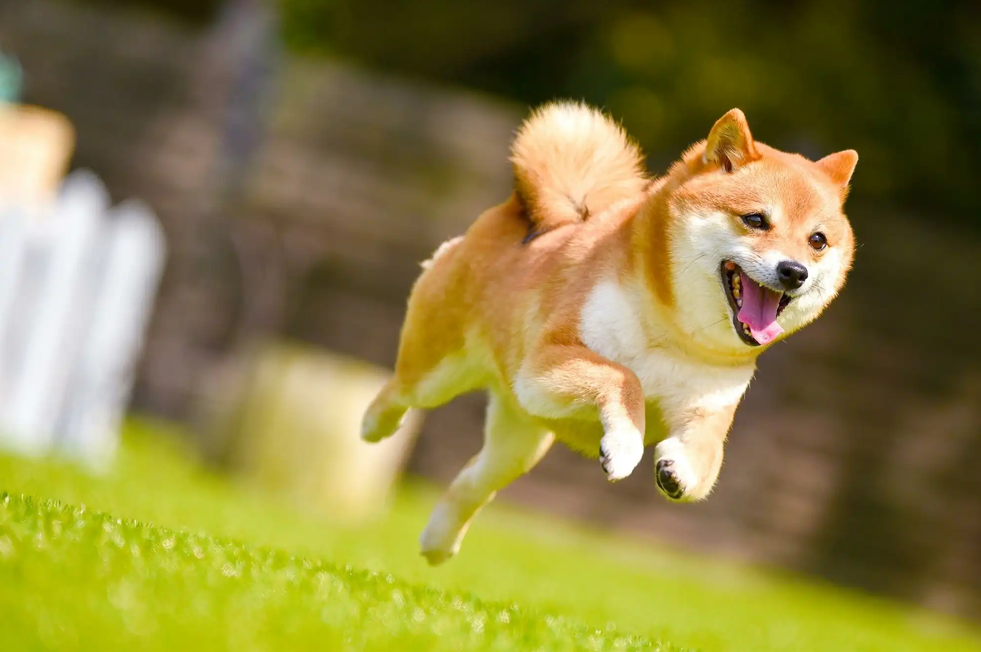
source: https://cooljapan-videos.com/tw/articles/epe0y86g

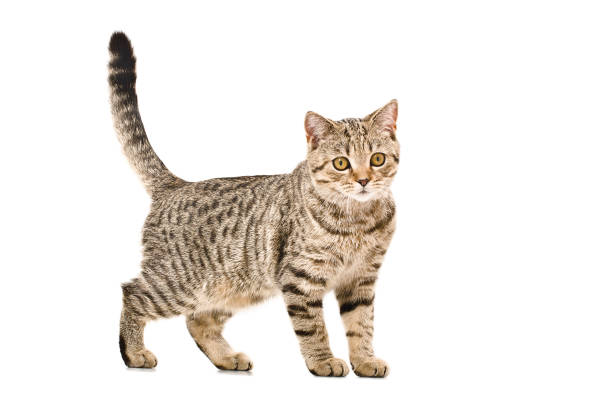
source: https://www.istockphoto.com/photo/young-cat-scottish-straight-gm1098182434-294927481

We will use the **llava-phi3** model that we installed to request a description of the images:

In [89]:
import ollama

response2 = ollama.chat(
    model="llava-phi3",
    messages=[
        {
            "role": "user",
            "content": "What is this image about?",
            "images": ["./pics/example1.png"],  # Image with the dog
        },
    ],
)

display(Markdown(response2["message"]["content"]))

This image captures a delightful moment of a Shiba Inu dog in mid-air, running through a grassy field. The dog, with its vibrant orange and white fur, appears to be leaping upwards, perhaps chasing after something or simply enjoying the freedom of movement. Its tail is raised high in excitement and its pink tongue is sticking out, adding to the sense of joyous energy captured in this frame.

The field itself is a lush green, suggesting it might be spring or summer when nature is at its most vibrant. In the distance, there's a white fence that marks the boundary of the field. Further beyond, you can see trees standing tall against the sky, their leaves rustling in the unseen breeze.

The perspective of the photo suggests it was taken from ground level, looking up at the dog as it jumps, which emphasizes the height and energy of the leap. The overall composition of this image conveys a sense of freedom and joy that only nature can provide.

In [90]:
response3 = ollama.chat(
    model="llava-phi3",
    messages=[
        {
            "role": "user",
            "content": "What is this image about?",
            "images": ["./pics/example2.jpg"],  # Image with the cat
        },
    ],
)

display(Markdown(response3["message"]["content"]))

The image features a **tabby cat** with a coat of **gray and black stripes**. The cat's body is primarily gray, adorned with distinctive black stripes that extend down its legs and back, creating the classic tabby pattern. Its eyes are a striking yellow color, adding to its unique appearance.

The cat is captured in an active stance, walking on all fours. It appears alert and curious, perhaps exploring its surroundings or reacting to something off-camera. The background of the image is **white**, which contrasts with the cat's gray coat and black stripes, making it stand out prominently in the frame.

The cat's tail, also adorned with black stripes, points upwards as if caught mid-movement or signaling to something. The overall composition of the image suggests a candid moment captured during the cat's daily activities.


### ** >>> Exercise 10 (Take home): **  

Try asking the model with one image of your choosing. Is the description accurate? Why?

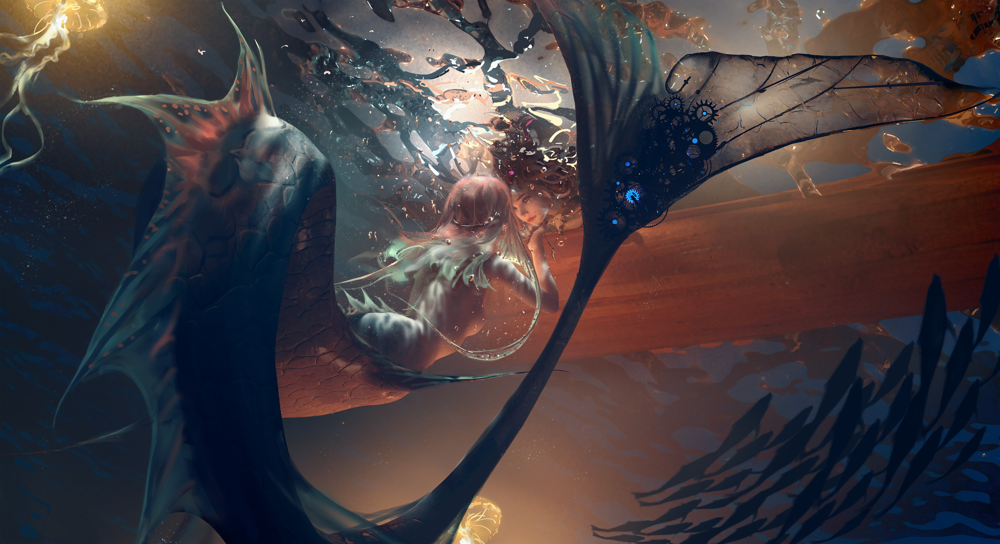

In [ ]:
from IPython.display import Image, display

display(
    Image(
        filename="/home/S113062628/project/Data Mining/DM-Autumn-2024-Lab-2/DM2024-Lab2-Master/pics/3_OceanDream3_8k.jpg"
    )
)

In [92]:
# Answer here
response3 = ollama.chat(
    model="llava-phi3",
    messages=[
        {
            "role": "user",
            "content": "What is this image about?",
            "images": ["./pics/3_OceanDream3_8k.jpg"],
        },
    ],
)

display(Markdown(response3["message"]["content"]))

The image presents a surreal scene set against the backdrop of a dark blue-green ocean. Dominating the right side of the frame is a large, ethereal octopus with hues of green and white. The octopus has tentacles that fan out, each adorned with rippling lines like waves in motion. These tentacles are not merely decorative but serve as platforms for small creatures that seem to be playfully dancing on them.

On the left side of the image, a figure can be seen floating towards the right, their identity obscured by the ocean's vast expanse. The overall composition of the image suggests an otherworldly setting, where sea creatures and unknown entities coexist in harmony.

In [94]:
"""
The description provided by Ollama seems unusual, as the image is a piece of 
digital art rather than a typical scene.
"""

'\nThe description provided by Ollama seems unusual, as the image is a piece of \ndigital art rather than a typical scene.\n'

### 10.3 Retrieval-Augmented Generation (RAG)
RAG (Retrieval-Augmented Generation) is a technique where a language model combines document retrieval with text generation. In RAG, a retrieval system first finds relevant documents or text chunks, and then the language model uses this retrieved information to generate a more informed and accurate response. This method enhances the model's ability to answer questions by grounding its responses in real, external data.

In the following code, we will load a webpage as a document, which allows us to retrieve text from a URL. After loading the content, we will split the document into smaller, manageable chunks, making it easier for our model to process. Then, we'll generate embeddings for these chunks with a specified LLM model (e.g., Llama3.2). These embeddings will be stored in a vector database, which enables us to perform similarity searches. By setting up this retrieval system, we can use a RAG chain to answer questions. The retriever finds relevant text chunks from the document based on a query, and the LLM generates a response by incorporating this retrieved information, making the answers more grounded and accurate.

In [95]:
import ollama
import bs4
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain_community.document_loaders import WebBaseLoader
from langchain_community.vectorstores import Chroma
from langchain_community.embeddings import OllamaEmbeddings
from langchain_core.output_parsers import StrOutputParser
from langchain_core.runnables import RunnablePassthrough

llm_model = "llama3.2"  # You can change to the one of your preference


# Function to load, split, and retrieve documents
def load_and_retrieve_docs(url):
    loader = WebBaseLoader(web_paths=(url,), bs_kwargs=dict())
    docs = loader.load()  # We will load the URL that will serve as our data source
    text_splitter = RecursiveCharacterTextSplitter(
        chunk_size=1000, chunk_overlap=200
    )  # We will divide the URL in chunks of text for easier comparison in the vector space
    splits = text_splitter.split_documents(docs)
    # print(splits) #You can print this to see how the chunks in the url where split
    embeddings = OllamaEmbeddings(
        model=llm_model
    )  # Generating embeddings with our chosen model
    vectorstore = Chroma.from_documents(
        documents=splits, embedding=embeddings
    )  # Our vector space for comparison
    return vectorstore.as_retriever()


url = "https://www.ibm.com/topics/large-language-models"
# Create the retriever
retriever = load_and_retrieve_docs(url)


def format_docs(docs):
    return "\n\n".join(
        doc.page_content for doc in docs
    )  # Format the retrieved docs in an orderly manner for prompting


# Define the Ollama LLM function
def ollama_llm(question, context):
    formatted_prompt = f"Question: {question}\n\nContext: {context}"
    response = ollama.chat(
        model="llama3.2", messages=[{"role": "user", "content": formatted_prompt}]
    )
    return response["message"]["content"]


# Define the RAG chain
def rag_chain(question):
    retrieved_docs = retriever.invoke(question)
    formatted_context = format_docs(retrieved_docs)
    return ollama_llm(question, formatted_context)


# Use the RAG chain
result = rag_chain("What are the related solutions of IBM with LLMs?")
display(Markdown(result))

USER_AGENT environment variable not set, consider setting it to identify your requests.
/tmp/ipykernel_32103/2310563568.py:22: LangChainDeprecationWarning: The class `OllamaEmbeddings` was deprecated in LangChain 0.3.1 and will be removed in 1.0.0. An updated version of the class exists in the :class:`~langchain-ollama package and should be used instead. To use it run `pip install -U :class:`~langchain-ollama` and import as `from :class:`~langchain_ollama import OllamaEmbeddings``.
  embeddings = OllamaEmbeddings(


IBM's related solutions with Large Language Models (LLMs) include:

1. Watsonx.ai: IBM has launched its Granite model series on watsonx.ai, which serves as the generative AI backbone for other IBM products like:
2. Watsonx Assistant: a conversational AI service that leverages LLMs to generate human-like responses.
3. Watsonx Orchestrate: a platform that enables users to create and manage workflows, leveraging the power of LLMs.

These solutions demonstrate IBM's efforts to integrate LLMs into its product offerings, enhancing natural language understanding (NLU) and content generation capabilities across various industries.


### **Actual content in the URL:**
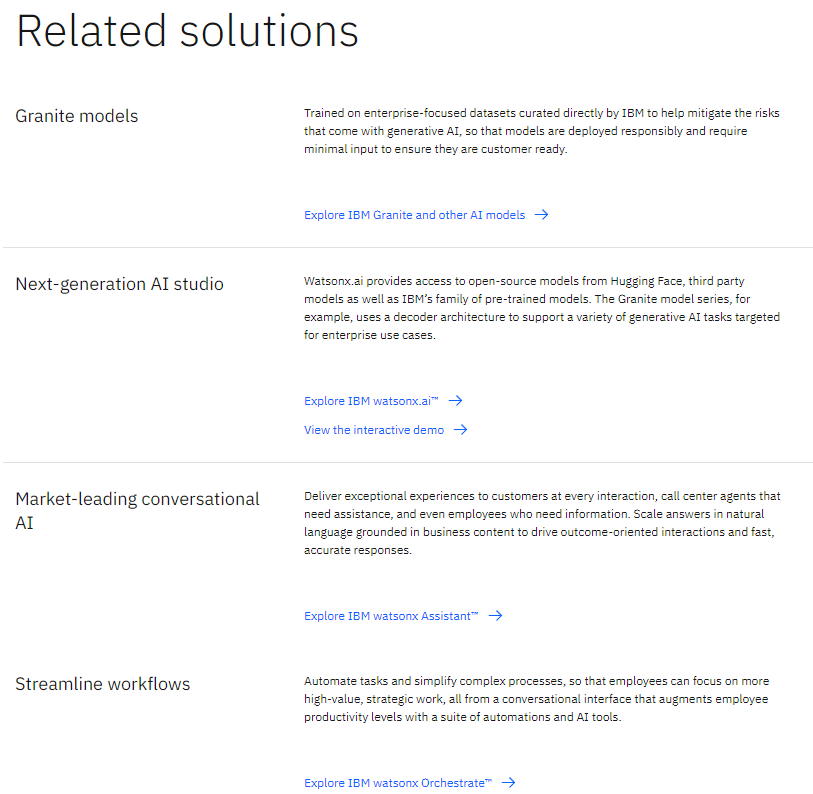

source: https://www.ibm.com/topics/large-language-models



### ** >>> Exercise 11 (Take home): **  

Try to modify the code to make it accept **three URLs**, or **three text documents** of your choosing. After modifying it, make **three prompts/questions** with information that can be found in each of the documents/urls, **compare the accuracy of the response** with the actual answer. Investigate and discuss the advantages and disadvantages of RAG systems.

In [ ]:
def load_and_retrieve_docs(url):
    loader = WebBaseLoader(web_paths=(url,), bs_kwargs=dict())
    docs = loader.load()
    text_splitter = RecursiveCharacterTextSplitter(chunk_size=1000, chunk_overlap=200)
    splits = text_splitter.split_documents(docs)
    embeddings = OllamaEmbeddings(model=llm_model)
    vectorstore = Chroma.from_documents(documents=splits, embedding=embeddings)
    return vectorstore.as_retriever()


url = "https://www.ibm.com/topics/large-language-models"
retriever = load_and_retrieve_docs(url)


def format_docs(docs):
    return "\n\n".join(doc.page_content for doc in docs)


def ollama_llm_multi(questions, context):
    formatted_prompt = (
        "\n\n".join([f"Question {i+1}: {q}" for i, q in enumerate(questions)])
        + f"\n\nContext: {context}"
    )

    response = ollama.chat(
        model="llama3.2", messages=[{"role": "user", "content": formatted_prompt}]
    )
    return response["message"]["content"]


def rag_chain_multi(questions):
    all_retrieved_docs = []

    for question in questions:
        retrieved_docs = retriever.invoke(question)
        all_retrieved_docs.extend(retrieved_docs)

    formatted_context = format_docs(all_retrieved_docs)
    return ollama_llm_multi(questions, formatted_context)


questions = [
    "What are the related solutions of IBM with LLMs?",
    "What is next generation AI?",
    "How does a conversational interface with AI boost employee productivity?",
]

result = rag_chain_multi(questions)
display(Markdown(result))

I'll be happy to help you with your questions about IBM's solutions related to LLMs.

1. What are the related solutions of IBM with LLMs?

IBM has launched its Granite model series on watsonx.ai, which has become the generative AI backbone for other IBM products like watsonx Assistant and watsonx Orchestrate. This is a significant development in IBM's efforts to integrate Large Language Models (LLMs) into its various solutions.

2. What is next generation AI?

The text does not explicitly define "next generation AI," but based on the context, it appears that next-generation AI refers to the latest advancements and developments in artificial intelligence, particularly those related to LLMs. This could include new models, architectures, or applications of AI that build upon the current state-of-the-art.

3. How does a conversational interface with AI boost employee productivity?

A conversational interface with AI can significantly boost employee productivity by providing quick access to information, automating routine tasks, and enabling employees to focus on more complex and high-value tasks. For example, IBM's watsonx Assistant and Orchestrate products use LLMs to provide employees with instant answers to their questions, freeing up time for them to concentrate on critical work. This can lead to increased efficiency, improved productivity, and enhanced overall work experience.

Let me know if you have any further questions or need clarification on these points!

In [ ]:
"""
Asking three questions at once can lead to responses where answers might be 
influenced by other questions, increasing the risk of generating hallucinations 
or irrelevant information.
"""

### 10.4 Generating LLM Embeddings:
LLM embeddings are dense vector representations of text generated by Large Language Models. These embeddings, like we have already seen in the lab, capture the semantic meaning and relationships between words, phrases, or even entire documents by mapping them into a high-dimensional space where similar pieces of text are placed closer together. What makes LLM embeddings special is that they are contextual and rich in meaning, meaning the same word can have different embeddings based on its surrounding context.

For example, the word **"bank"** would have different embeddings in the sentences **"I sat by the river bank"** and **"I deposited money in the bank."** This ability to understand and encode context enables LLM embeddings to outperform traditional techniques (like TF-IDF or one-hot encoding) by providing a deeper, more nuanced representation of language.

Additionally, LLM embeddings are pre-trained on vast amounts of data, allowing them to generalize well across different tasks (like classification, clustering, or similarity detection) without the need for extensive retraining. This makes them highly valuable in many natural language processing tasks today.

**Now let's generate some embeddings with llama 3.2 for our dataset:**

In [98]:
import pandas as pd
import ollama

# Let's copy our dataframes for training and testing
df_train = train_df
df_test = test_df


# Define a function to generate embeddings
def generate_embeddings(row, text_column_name="text"):
    embeddings = ollama.embeddings(
        model="llama3.2",
        prompt=row[text_column_name],
    )
    return embeddings["embedding"]

In [99]:
# We use the text column
column_name = "text"

# Apply the function to the specified column and store the result in a new column 'embeddings'
df_train["embeddings"] = df_train.apply(
    lambda row: generate_embeddings(row, column_name), axis=1
)

In [100]:
df_test["embeddings"] = df_test.apply(
    lambda row: generate_embeddings(row, column_name), axis=1
)

In [101]:
df_train  # We can see the new column with the embeddings

,id,text,emotion,intensity,text_tokenized,embeddings
2411,30407,Watch this amazing live.ly broadcast by @ittzd...,joy,0.483,"[Watch, this, amazing, live.ly, broadcast, by,...","[-2.4579195976257324, 1.8479734659194946, -0.3..."
3448,40621,Jay Z and Brad Pitt cheated ..Bey stayed Angie...,sadness,0.320,"[Jay, Z, and, Brad, Pitt, cheated, .., Bey, st...","[-3.4213852882385254, 0.7130124568939209, 2.41..."
2115,30111,"What a great training course, lots of photos, ...",joy,0.740,"[What, a, great, training, course, ,, lots, of...","[-1.6536946296691895, 0.8555185198783875, 1.86..."
1233,20376,Appropriate that first secretary at permanent ...,fear,0.583,"[Appropriate, that, first, secretary, at, perm...","[0.34588924050331116, -0.8215805292129517, 1.6..."
628,10628,"@ToddDoug @Ziggomattic Yeah, this actually sup...",anger,0.396,"[@, ToddDoug, @, Ziggomattic, Yeah, ,, this, a...","[-0.645428478717804, 0.7625687718391418, -1.91..."
...,...,...,...,...,...,...
707,10707,@l1ght__eyes u tried boiling em takes years too,anger,0.354,"[@, l1ght__eyes, u, tried, boiling, em, takes,...","[-1.7238672971725464, -0.12577760219573975, 2...."
347,10347,@Alanafergusson snap meee,anger,0.521,"[@, Alanafergusson, snap, meee]","[-2.710637092590332, -1.179465889930725, -0.63..."
37,10037,@SunandBeachBum 'you people' infuriate me!,anger,0.792,"[@, SunandBeachBum, 'you, people, ', infuriate...","[0.09456446021795273, 0.28199502825737, 0.3037..."
3544,40717,All clouded out.\n\n Considering using a camer...,sadness,0.250,"[All, clouded, out.\n\n, Considering, using, a...","[-1.012136697769165, 0.9165167212486267, -1.05..."


In [102]:
df_test  # We can see the new column with the embeddings

,id,text,emotion,intensity,embeddings
280,40793,"Hello my dear friends, I will be back online t...",sadness,0.417,"[-1.294469952583313, -0.33604884147644043, 0.4..."
253,30882,@chencouture LMAO Is it that 'so slutty' hater...,joy,0.700,"[0.19596916437149048, 1.5261366367340088, -1.0..."
117,21180,The 2nd step to beating #anxiety or #depressio...,fear,0.479,"[-1.4074207544326782, 0.779538631439209, -0.05..."
52,10909,"I miss my gran singing Rawhide, in her deep ba...",anger,0.292,"[0.32991355657577515, 1.3073071241378784, -1.9..."
89,21152,"Really.....#Jumanji 2....w/ The Rock, Jack Bla...",fear,0.542,"[-0.32395583391189575, 1.1804858446121216, 0.5..."
...,...,...,...,...,...
22,10879,@TrueAggieFan oh so that's where Brian was! Wh...,anger,0.438,"[-1.781699538230896, 0.3292962908744812, 0.735..."
137,21200,My Modern Proverb: 'Don't let anyone intimidat...,fear,0.312,"[-0.45179590582847595, 1.2539640665054321, -2...."
242,30871,@hesham786 that's the spirit #optimism,joy,0.396,"[-2.670034646987915, 0.3222173750400543, -0.01..."
276,40789,"Stars, when you shine,\nYou know how I feel.\n...",sadness,0.292,"[0.05329540744423866, 0.03059418313205242, -0...."


Now let's train some models with these embeddings:

**KNeighborsClassifier (KNN)**: KNN is a simple, instance-based machine learning algorithm used for classification. It works by finding the 'k' nearest neighbors to a data point based on a distance metric (e.g., Euclidean distance) and assigning the most common class among those neighbors to the data point. KNN is non-parametric, meaning it doesn’t assume a specific form for the underlying data distribution, and it classifies points based on their similarity to other points in the training set. It's easy to understand and implement, though it can become computationally expensive with large datasets.

In [103]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Let's use the new Llama 3.2 embeddings as our training features and the emotions as our labels
X_train = df_train["embeddings"].tolist()
y_train = df_train["emotion"]


# Initialize the KNN classifier
knn = KNeighborsClassifier(n_neighbors=10)

knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=10)

In [104]:
len(df_train["embeddings"][0])  # Llama 3.2 embedding dimension is 3072

3072

In [105]:
X_test = df_test["embeddings"].tolist()
y_test = df_test["emotion"]

# Predicting the label for the test data
y_pred = knn.predict(X_test)

# Calculate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)

print(f"KNN Accuracy: {accuracy}")

KNN Accuracy: 0.4697406340057637


In [106]:
## precision, recall, f1-score,
from sklearn.metrics import classification_report

print(classification_report(y_true=y_test, y_pred=y_pred))

              precision    recall  f1-score   support

       anger       0.41      0.46      0.43        84
        fear       0.56      0.53      0.54       110
         joy       0.43      0.46      0.44        79
     sadness       0.46      0.41      0.43        74

    accuracy                           0.47       347
   macro avg       0.47      0.46      0.46       347
weighted avg       0.47      0.47      0.47       347



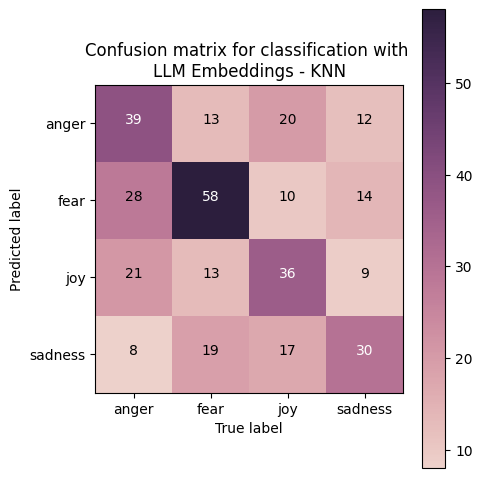

In [107]:
## check by confusion matrix
from sklearn.metrics import confusion_matrix

cm2 = confusion_matrix(y_true=y_test, y_pred=y_pred)
my_tags = ["anger", "fear", "joy", "sadness"]
plot_confusion_matrix(
    cm2,
    classes=my_tags,
    title="Confusion matrix for classification with \nLLM Embeddings - KNN",
)

Now let's also try to apply our **Neural Network** to these embeddings:

In [108]:
X_llama_train = np.vstack(df_train["embeddings"].to_numpy())  # Defining our train set

In [109]:
X_llama_test = np.vstack(df_test["embeddings"].to_numpy())  # Defining our test set

In [110]:
X_llama_train.shape  # (Number of data, Llama 3.2 embedding size)

(3613, 3072)

In [111]:
X_llama_test.shape  # (Number of data, Llama 3.2 embedding size)

(347, 3072)

In [112]:
# One-hot encoding our labels
y_train_llama = label_encode(label_encoder, y_train)
y_test_llama = label_encode(label_encoder, y_test)

In [113]:
# I/O check
input_shape_llama = len(X_llama_train[0])
print("input_shape: ", input_shape_llama)

output_shape = len(label_encoder.classes_)
print("output_shape: ", output_shape)

input_shape:  3072
output_shape:  4


In [114]:
# We try the same Neural Network Model Again
from keras.models import Model
from keras.layers import Input, Dense
from keras.layers import ReLU, Softmax

# input layer
model_input = Input(shape=(input_shape_llama,))  # 3072
X = model_input

# 1st hidden layer
X_W1 = Dense(units=64)(X)  # 64
H1 = ReLU()(X_W1)

# 2nd hidden layer
H1_W2 = Dense(units=64)(H1)  # 64
H2 = ReLU()(H1_W2)

# output layer
H2_W3 = Dense(units=output_shape)(H2)  # 4
H3 = Softmax()(H2_W3)

model_output = H3

# create model
model = Model(inputs=[model_input], outputs=[model_output])

# loss function & optimizer
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

# show model construction
model.summary()  # We can notice that our parameter numbers went up because of the increase in the dimension of our input

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 3072)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 64)             │       196,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 4)              │           260 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ softmax_1 (Softmax)             │ (None, 4)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 201,092 (785.52 KB)

 Trainable params: 201,092 (785.52 KB)

 Non-trainable params: 0 (0.00 B)

In [115]:
from keras.callbacks import CSVLogger

csv_logger = CSVLogger("logs/training_log_2.csv")

# training setting
epochs = 25
batch_size = 32

# training!
history = model.fit(
    X_llama_train,
    y_train_llama,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=[csv_logger],
    validation_data=(X_llama_test, y_test_llama),
)
print("training finish")

Epoch 1/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.4291 - loss: 1.3742 - val_accuracy: 0.5562 - val_loss: 1.0927
Epoch 2/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6526 - loss: 0.8516 - val_accuracy: 0.5418 - val_loss: 1.0932
Epoch 3/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7625 - loss: 0.6453 - val_accuracy: 0.5648 - val_loss: 1.1081
Epoch 4/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8128 - loss: 0.5089 - val_accuracy: 0.5159 - val_loss: 1.4532
Epoch 5/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8574 - loss: 0.4176 - val_accuracy: 0.5245 - val_loss: 1.2608
Epoch 6/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8786 - loss: 0.3294 - val_accuracy: 0.5476 - val_loss: 1.3889
Epoch 7/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9085 - loss: 0.2710 - val_accuracy: 0.5476 - val_loss: 1.5444
Epoch 8/25
113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9063 - loss: 0.2524 - val_accuracy: 0.

In [116]:
## predict
pred_result = model.predict(X_llama_test, batch_size=128)
pred_result[:5]

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


array([[2.6601457e-04, 6.3988751e-05, 9.9484992e-01, 4.8201159e-03],
       [1.5794304e-01, 4.3075792e-02, 3.9853504e-01, 4.0044603e-01],
       [1.1343272e-02, 4.9648110e-02, 5.4991042e-06, 9.3900305e-01],
       [2.7889750e-04, 4.7420849e-06, 9.9517030e-01, 4.5460304e-03],
       [2.9740724e-07, 9.9999946e-01, 4.2344896e-09, 2.1807118e-07]],
      dtype=float32)

In [117]:
pred_result = label_decode(label_encoder, pred_result)
pred_result[:5]

array(['joy', 'sadness', 'sadness', 'joy', 'fear'], dtype=object)

In [118]:
from sklearn.metrics import accuracy_score

# Accuracy
print(
    "testing accuracy: {}".format(
        round(accuracy_score(label_decode(label_encoder, y_test_llama), pred_result), 2)
    )
)

testing accuracy: 0.56


In [119]:
# Let's take a look at the training log
training_log = pd.DataFrame()
training_log = pd.read_csv("logs/training_log_2.csv")
training_log

,epoch,accuracy,loss,val_accuracy,val_loss
0,0,0.484362,1.207653,0.556196,1.092654
1,1,0.661777,0.835435,0.541787,1.093188
2,2,0.748408,0.656514,0.564842,1.108114
3,3,0.796291,0.543462,0.515850,1.453179
4,4,0.839469,0.439018,0.524496,1.260804
5,5,0.866039,0.357275,0.547550,1.388937
6,6,0.904512,0.282769,0.547550,1.544368
7,7,0.898422,0.278444,0.544669,1.542222
8,8,0.927207,0.220292,0.561960,1.634088
9,9,0.942707,0.177470,0.553314,1.880648


In [120]:
print(
    classification_report(
        y_true=label_decode(label_encoder, y_test_llama), y_pred=pred_result
    )
)

              precision    recall  f1-score   support

       anger       0.52      0.58      0.55        84
        fear       0.61      0.59      0.60       110
         joy       0.57      0.59      0.58        79
     sadness       0.50      0.43      0.46        74

    accuracy                           0.56       347
   macro avg       0.55      0.55      0.55       347
weighted avg       0.56      0.56      0.56       347



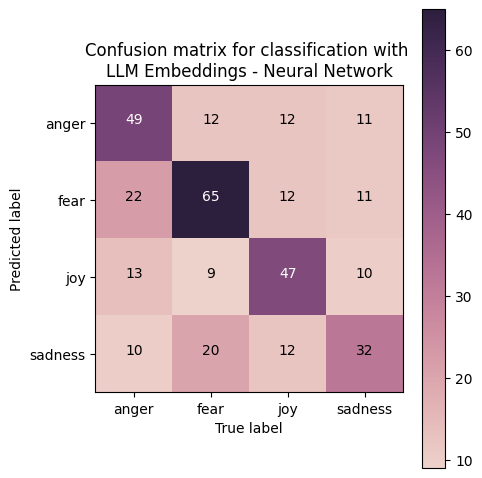

In [121]:
## check by confusion matrix
from sklearn.metrics import confusion_matrix

cm3 = confusion_matrix(
    y_true=label_decode(label_encoder, y_test_llama), y_pred=pred_result
)
my_tags = ["anger", "fear", "joy", "sadness"]
plot_confusion_matrix(
    cm3,
    classes=my_tags,
    title="Confusion matrix for classification with \nLLM Embeddings - Neural Network",
)

### ** >>> Exercise 12 (Take home): **

Follow Exercise 6 again and Plot the Training and Validation Accuracy and Loss for the results of this Neural Network. Compare the results of both KNN and the NN we just implemented. Discuss about why we obtained these results with the LLM Embeddings compared to the results of the other models implemented in this Lab.

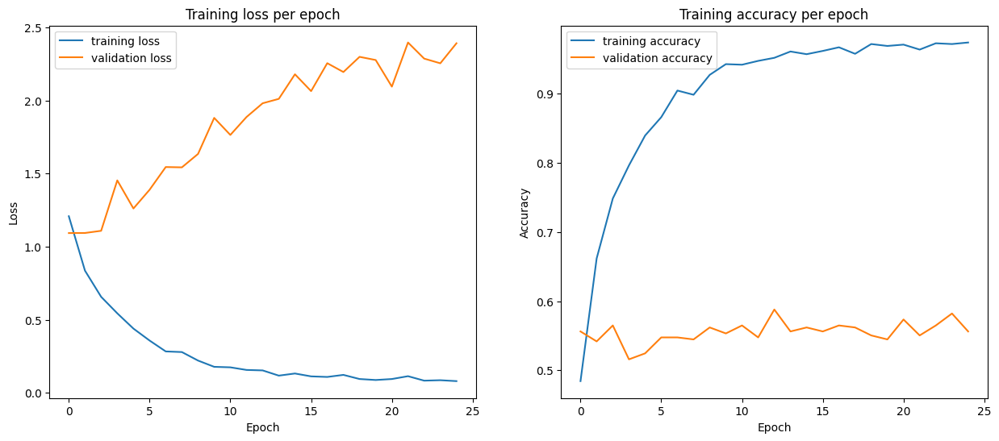

In [123]:
# Answer here
plot_training_logs(training_log)

### 10.5 Few-Shot Prompting Classification:
Few-shot prompting classification for LLMs involves giving the model a few labeled examples (typically 5 or fewer) within a prompt to guide it in performing a classification task. Instead of needing extensive training, the LLM uses these examples to understand the task and classify new inputs. This approach is significant in current research because it allows LLMs to perform well on tasks with minimal labeled data, reducing the need for large training datasets and making it highly flexible for various NLP tasks, including those in low-resource languages or niche domains.

In this lab exercise, we will explore zero-shot, 1-shot, and 5-shot prompting for classification using an LLM:

- Zero-shot means the model performs classification without seeing any examples beforehand.
- 1-shot provides the model with just one labeled example per class to guide its classification.
- 5-shot gives the model five labeled examples per class to improve its understanding of the task.

Since processing large datasets can be computationally demanding, we will only sample 20 test texts per emotion for the classification task, allowing us to test the model's performance more efficiently without using the entire test set.

**Process order: Explanation Prompt -> Examples + labels (if it is not zero-shot) -> Text to classify**

**Recommendation for the explanation prompt:** Explain to the model that it is a classification model of certain labels, and to only output the label word, and no other explanation. In this case if the model does not follow the instructions we are retrying the same text until it outputs one of the accepted labels for it.

In [124]:
import ollama
import random
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

# Define the emotion labels
emotions = ["anger", "fear", "joy", "sadness"]
# Define the model to use for few-shot prompting
model_ollama = "llama3.2"


# Function to sample examples per emotion category
def sample_few_shots(df, emotions, num_samples=5):
    few_shot_examples = {}
    for emotion in emotions:
        few_shot_examples[emotion] = df[df["emotion"] == emotion].sample(
            n=num_samples, random_state=42
        )
    return few_shot_examples


# Function to build the prompt based on the number of examples (few-shot, 1-shot, zero-shot)
def build_prompt(examples, emotions, num_shots=5):
    classification_instructions = """
You are an emotion classification model. You will be given a text from social media and your task is to classify the text into one of the following emotion categories: anger, fear, joy, or sadness.
You must only output one of these four labels. Do not provide any additional information or explanation. Just output the emotion label as one word.
    """

    prompt = classification_instructions + "\n\n"

    if num_shots > 0:
        prompt += f"Examples: \n"
        for emotion in emotions:
            for _, row in examples[emotion].iterrows():
                prompt += f"Text: {row['text']}\nEmotion: {emotion}\n\n"  # Show the examples in the same format it will be shown for the classification text
                if (
                    num_shots == 1
                ):  # If 1-shot, break after the first example for each emotion
                    break
    return prompt


# Function to classify using the LLM with retry for incorrect responses
def classify_with_llm(test_text, prompt_base):
    valid_emotions = ["anger", "fear", "joy", "sadness"]
    response = None
    while not response or response not in valid_emotions:
        full_prompt = f"{prompt_base}\nClassification:\nText: {test_text}\nEmotion: "  # The classification text will leave the emotion label to be filled in by the LLM
        result = ollama.chat(
            model=model_ollama, messages=[{"role": "user", "content": full_prompt}]
        )
        response = (
            result["message"]["content"].strip().lower()
        )  # Clean and standardize the response
        if response not in valid_emotions:  # Retry if not a valid response
            print(f"Invalid response: {response}. Asking for reclassification.")
    return response


# Main function to run the experiment with the option for zero-shot, 1-shot, or 5-shot prompting
def run_experiment(df_train, df_test, test_samples=5, num_shots=5):
    # Sample examples for few-shot prompting based on num_shots
    if num_shots > 0:
        few_shot_examples = sample_few_shots(df_train, emotions, num_samples=num_shots)
        prompt_base = build_prompt(few_shot_examples, emotions, num_shots=num_shots)
    else:
        prompt_base = build_prompt(
            None, emotions, num_shots=0
        )  # Zero-shot has no examples

    # Prepare to classify the test set
    predictions = []
    true_labels = []
    print(prompt_base)
    # Sample 20 examples per emotion for the test set to classify
    test_samples = sample_few_shots(df_test, emotions, num_samples=test_samples)

    # Classify 20 test examples (5 from each category) and save predictions
    for emotion in emotions:
        for _, test_row in test_samples[emotion].iterrows():
            test_text = test_row["text"]
            predicted_emotion = classify_with_llm(test_text, prompt_base)
            predictions.append(predicted_emotion)
            true_labels.append(emotion)

    # Calculate accuracy
    accuracy = accuracy_score(true_labels, predictions)
    print(f"Accuracy: {accuracy * 100:.2f}%")

    # Classification report
    print(classification_report(y_true=true_labels, y_pred=predictions))

    # Plot confusion matrix
    cm = confusion_matrix(y_true=true_labels, y_pred=predictions)
    my_tags = ["anger", "fear", "joy", "sadness"]
    plot_confusion_matrix(
        cm,
        classes=my_tags,
        title=f"Confusion matrix for classification with \n{num_shots}-shot prompting",
    )


You are an emotion classification model. You will be given a text from social media and your task is to classify the text into one of the following emotion categories: anger, fear, joy, or sadness.
You must only output one of these four labels. Do not provide any additional information or explanation. Just output the emotion label as one word.
    


Invalid response: frustration. Asking for reclassification.
Accuracy: 42.50%
              precision    recall  f1-score   support

       anger       0.33      0.50      0.40        20
        fear       0.00      0.00      0.00        20
         joy       0.48      0.80      0.60        20
     sadness       0.57      0.40      0.47        20

    accuracy                           0.42        80
   macro avg       0.35      0.43      0.37        80
weighted avg       0.35      0.42      0.37        80



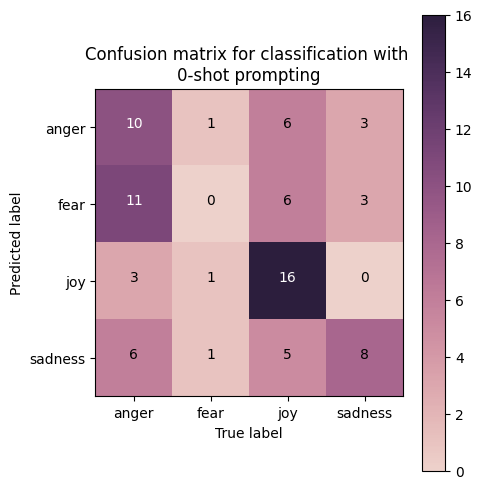

In [138]:
# Example of running the experiment with zero-shot prompting
run_experiment(df_train, df_test, test_samples=20, num_shots=0)


You are an emotion classification model. You will be given a text from social media and your task is to classify the text into one of the following emotion categories: anger, fear, joy, or sadness.
You must only output one of these four labels. Do not provide any additional information or explanation. Just output the emotion label as one word.
    

Examples: 
Text: 😳The intensity that @sydneyswans play at is extraordinary #relentless #AFLCatsSwans #AFLFinals 🏉👏🏿
Emotion: anger

Text: Good Morning!!!\n\n #leadership #healthcareIT #socialmedia #connector #ceo #writer #AI #EQ #security #bigdata #Growthhacking #tech 
Emotion: fear

Text: @bijayjanand\nIt's not just a treat for viewers to watch u as janak, it's simply a treat for our soul, mind, thoughts. #hearty respect 🙏🙏
Emotion: joy

Text: It's dark
Emotion: sadness


Accuracy: 47.50%
              precision    recall  f1-score   support

       anger       0.39      0.85      0.53        20
        fear       0.00      0.00      0.00

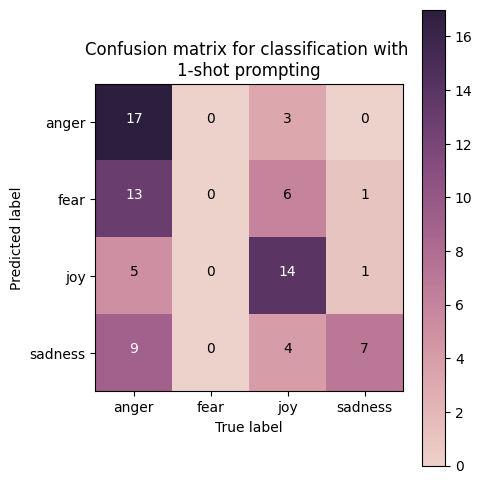

In [135]:
# Example of running the experiment with 1-shot prompting
run_experiment(df_train, df_test, test_samples=20, num_shots=1)


You are an emotion classification model. You will be given a text from social media and your task is to classify the text into one of the following emotion categories: anger, fear, joy, or sadness.
You must only output one of these four labels. Do not provide any additional information or explanation. Just output the emotion label as one word.
    

Examples: 
Text: 😳The intensity that @sydneyswans play at is extraordinary #relentless #AFLCatsSwans #AFLFinals 🏉👏🏿
Emotion: anger

Text: @LeKingCoq @MistaAggy @GiovanniiDC The way my blood is boiling, little bastards!
Emotion: anger

Text: @lethargytyler ehhh I guess. I want to everyone I've ever burst out laughing in front of😂
Emotion: anger

Text: @alyssasimpson21 I gave up KENDRICK LAMAR to eat barbecue with him. #bitter
Emotion: anger

Text: Why are people that don't have iPhones so bitter about iPhones???? Can someone explain
Emotion: anger

Text: Good Morning!!!\n\n #leadership #healthcareIT #socialmedia #connector #ceo #writer #AI 

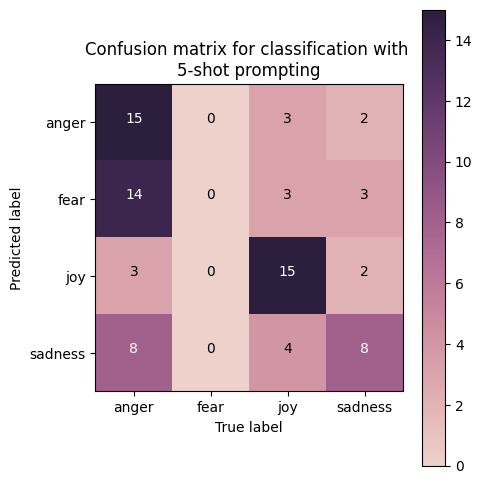

In [136]:
# Example of running the experiment with 5-shot prompting
run_experiment(df_train, df_test, test_samples=20, num_shots=5)

### ** >>> Exercise 13 (Take home): **

Compare and discuss the results of the zero-shot, 1-shot and 5-shot classification.

In [139]:
# Answer here
"""
The difference between zero-shot and one-shot performance is more substantial 
compared to the difference between one-shot and five-shot, or other similar 
shot comparisons. Excluding zero-shot and one-shot scenarios, accuracy still 
increases slightly, but this improvement appears to plateau and may largely be 
a bias effect. Across all shot variations, predictions in the fear category 
consistently fail almost 100% of the time, suggesting a potential issue with 
Ollama itself or some other issue. Another observation is that as the number 
of shots increases, accuracy stabilizes, showing less fluctuation compared to 
lower-shot scenarios, though there are still minor variations. 
"""

'\nThe difference between zero-shot and one-shot performance is more substantial \ncompared to the difference between one-shot and five-shot, or other similar \nshot comparisons. Excluding zero-shot and one-shot scenarios, accuracy still \nincreases slightly, but this improvement appears to plateau and may largely be \na bias effect. Across all shot variations, predictions in the fear category \nconsistently fail almost 100% of the time, suggesting a potential issue with \nOllama itself or some other issue. Another observation is that as the number \nof shots increases, accuracy stabilizes, showing less fluctuation compared to \nlower-shot scenarios, though there are still minor variations. \n'

### 10.6 Extra LLM Materials:
So this will be it for the lab, but here are some extra materials if you would like to explore:
- How to use Gemini's LLM API from Google: [Gemini Collab](https://colab.research.google.com/github/google/generative-ai-docs/blob/main/site/en/gemini-api/docs/get-started/python.ipynb?fbclid=IwZXh0bgNhZW0CMTEAAR0-gg7cDIuaGfkeN5U3rusSNKj2jj7bIsL45sZWaM0NbTE7BSNtfzBeEGE_aem_yT5wAuL_G5E21iuuCYJXwA#scrollTo=hskqSKnJUHvp) (Free with some restrictions to the requests per minute.

- How to use OpenAI ChatGPT model's API (Not Free API): [Basics Video](https://www.youtube.com/watch?v=e9P7FLi5Zy8), [Basics GitHub](https://github.com/gkamradt/langchain-tutorials/blob/main/chatapi/ChatAPI%20%2B%20LangChain%20Basics.ipynb), [RAG's Basics Video](https://www.youtube.com/watch?v=9AXP7tCI9PI&t=300s), [RAG's Basics GitHub](https://github.com/techleadhd/chatgpt-retrieval)

- **Advanced topic - QLoRA (Quantized Low-Rank Adapter):** QLoRA is a method used to make fine-tuning large language models more efficient. It works by adding a small, trainable part (LoRA) to a pre-trained model, while keeping the rest of the model frozen. At the same time, it reduces the size of the model’s data using a process called quantization, which makes the model require less memory. This allows you to fine-tune large models without needing as much computational power, making it easier to adapt models for specific tasks. Materials: [Paper GitHub](https://github.com/artidoro/qlora?tab=readme-ov-file), [Llama 3 Application Video](https://www.youtube.com/watch?v=YJNbgusTSF0&t=512s),[Llama 3 Application GitHub](https://github.com/adidror005/youtube-videos/blob/main/LLAMA_3_Fine_Tuning_for_Sequence_Classification_Actual_Video.ipynb)

---